# Comparison of the annotators

## Annotator vs GOAT
COmpare how much the annotated images different from the GAOT prediction used as a baseline.

In [2]:
# imports
import os
import sys
from typing import List, Tuple
from tqdm import tqdm

sys.path.append(os.path.dirname(os.getcwd()))

import torch
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

from src.model.model import maskRCNNModel
from src.model.dataset import InferenceMaskRCNNDataset
from src.utils.data_utils import *
from src.utils.annotation_utils import *
from src.utils.utils import *
from src.utils.const import *


/Users/francesco/miniconda3/envs/colorec/lib/python3.12/site-packages/albumentations/__init__.py:28: UserWarning: A new version of Albumentations is available: '2.0.8' (you have '2.0.5'). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()


In [3]:
# dataset_1 = "../dataset/merge_alone_1_corrected_LT"
# dataset_2 = "../dataset/merge_alone_1_corrected_EK"

# dataset_1 = "../dataset/merge_alone_1_LT"
# dataset_2 = "../dataset/merge_alone_1_EK"

dataset_1 = "../dataset/Lucrezia"
dataset_2 = "../dataset/Ekin"

images_path_1 = get_images_paths(dataset_1)
annotations_1_paths = get_annotations_paths(images_path_1, dataset_1)
print(len(annotations_1_paths))
images_path_2 = get_images_paths(dataset_2)
annotations_2_paths = get_annotations_paths(images_path_2, dataset_2)
print(len(annotations_2_paths))

inference_ds = InferenceMaskRCNNDataset(images_path_1)

# load the model
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
model = maskRCNNModel()
model_weights_path = os.path.join(os.path.dirname(os.getcwd()), "model/best-checkpoint-114epoch.bin")
checkpoint = torch.load(model_weights_path, map_location=device)
model.load_state_dict(checkpoint['model_state_dict'])

100
100


TypeError: stat: path should be string, bytes, os.PathLike or integer, not list

In [ ]:
import pickle
if  os.path.exists("predictions.pkl"):
    predictions = pickle.load(open("predictions.pkl", "rb"))
else:
    # compute the predicted instances
    predictions = []
    for (image_norm, meta) in tqdm(inference_ds):
        bboxes_predicted, _, _ = predict_image(
                model=model,
                img=image_norm,
                threshold=0.9,
                orig_shape=(meta["height"], meta["width"]),
            )
        bboxes_predicted = bbox_goat_to_xyxy(goat_bboxes=bboxes_predicted)
        bboxes_predicted = bbox_xyxy_to_box(bboxes_predicted) # move to Box format
        predictions.append(bboxes_predicted)
    pickle.dump(predictions, open("predictions.pkl", "wb"))

Next we campare the annotations with the predictions of the model GOAT. In particular we are interested to statify the annotated boxes in the following cathegories.

1) **Left untouched**: the GOAT prediction was considered correct and the box haven't been modified (pred_bbox = annotated_bbox)

2) **Edited**: the prediction fo goat has been edited by the annotator. We identify these boxes as the ones that have an IOU higher then a given threshold (0.9?) with one of the prediction. Note thet we are not considering annotated boxes belong to the above calss.

3) **Added**: boxes that have been manyally added from the annotator, thast is all the annotated boxes that don't fall in any of the above classes.

4) **Removed**: boxes that have been manually deleted, that is bopxes predicted by the model that are not associated with boxes nethor from calls 1) nor from class 2).

In [ ]:

import warnings

def compare_annotations(predictions: List[List[Box]], annotations_paths: list, iou_threshold: float = 0.5) -> Tuple[List[int], List[int], List[int], List[int], List[int], List[int]]:    
    untouched = []
    edited = []
    added = []
    removed = []
    nr_predicted = []
    nr_annotated = []
    
    for bboxes_predicted, annotations_path in tqdm(zip(predictions, annotations_paths)):

        if not os.path.exists(annotations_path):
            warnings.warn(f"Annotations path {annotations_path} does not exist. Skipping the image.")
            continue

        nr_predicted.append(len(bboxes_predicted))

        # load the annotations
        bboxes_annotated = pd.read_csv(annotations_path, index_col=0, sep=",")
        bboxes_annotated = bbox_xyxy_to_box(bboxes_annotated)
        nr_annotated.append(len(bboxes_annotated))

        # compute the identical  and edited boxes
        identical = 0
        modified = 0
        for box_ann in bboxes_annotated:
            best_iou = 0.0
            best_bbox_pred = None
            best_bbox_ann = None
            for box_pred in bboxes_predicted:
                if box_ann == box_pred:
                    identical += 1
                    bboxes_predicted.remove(box_pred)
                    bboxes_annotated.remove(box_ann)
                    continue
                iou = compute_iou(box_ann, box_pred)
                if iou > iou_threshold and iou > best_iou:
                    best_iou = iou
                    best_bbox_pred = box_pred
                    best_bbox_ann = box_ann
            if best_iou > 0:
                modified += 1
                bboxes_predicted.remove(best_bbox_pred)
                bboxes_annotated.remove(best_bbox_ann)
        untouched.append(identical)

        
        edited.append(modified)
        # compute the added boxes
        added.append(len(bboxes_annotated))
        removed.append(len(bboxes_predicted))

    return untouched, edited, added, removed, nr_predicted, nr_annotated




### Compute the metrics

In [ ]:
predictions = pickle.load(open("predictions.pkl", "rb"))
untouched_1, edited_1, added_1, removed_1, nr_predicted_1, nr_annotated_1 = compare_annotations(predictions, annotations_1_paths)
for i, (untouched, edited, added, removed, nr_predicted, nr_annotated) in enumerate(zip(untouched_1, edited_1, added_1, removed_1, nr_predicted_1, nr_annotated_1)):
    assert added + untouched + edited == nr_annotated, f"The sum of added, untouched and edited boxes should be equal to the number of annotated boxes: {added} + {untouched} + {edited} != {nr_annotated}"
    assert removed + untouched + edited == nr_predicted, f"The sum of removed, untouched and edited boxes should be equal to the number of predicted boxes: {removed} + {untouched} + {edited} != {nr_predicted}"
# compute percentages
untoched_1_rel = [x/y for x, y in zip(untouched_1, nr_annotated_1) if y != 0] 
edited_1_rel = [x/y for x, y in zip(edited_1, nr_annotated_1) if y != 0]
added_1_rel = [x/y for x, y in zip(added_1, nr_annotated_1) if y != 0]
# removed_1_rel = [x/y for x, y in zip(removed_1, nr_annotated_1) if y != 0]

20it [00:00, 67.39it/s] 


In [ ]:
predictions = pickle.load(open("predictions.pkl", "rb"))
untouched_2, edited_2, added_2, removed_2, nr_predicted_2, nr_annotated_2 = compare_annotations(predictions, annotations_2_paths)
for i, (untouched, edited, added, removed, nr_predicted, nr_annotated) in enumerate(zip(untouched_2, edited_2, added_2, removed_2, nr_predicted_2, nr_annotated_2)):
    assert added + untouched + edited == nr_annotated, f"The sum of added, untouched and edited boxes should be equal to the number of annotated boxes: {added} + {untouched} + {edited} != {nr_annotated}"
    assert removed + untouched + edited == nr_predicted, f"The sum of removed, untouched and edited boxes should be equal to the number of predicted boxes: {removed} + {untouched} + {edited} != {nr_predicted}"
# compute percentages
untoched_2_rel = [x/y for x, y in zip(untouched_2, nr_annotated_2) if y != 0]
edited_2_rel = [x/y for x, y in zip(edited_2, nr_annotated_2) if y != 0]
added_2_rel = [x/y for x, y in zip(added_2, nr_annotated_2) if y != 0]
# removed_2_rel = [x/y for x, y in zip(removed_2, nr_annotated_2) if y != 0]

0it [00:00, ?it/s]/Users/francesco/Documents/Work/Colorectal-Cancer-Organoids-Detection/src/utils/annotation_utils.py:78: RuntimeWarning: overflow encountered in scalar multiply
  return (self.right - self.left) * (self.bottom - self.top)
20it [00:00, 86.96it/s] 


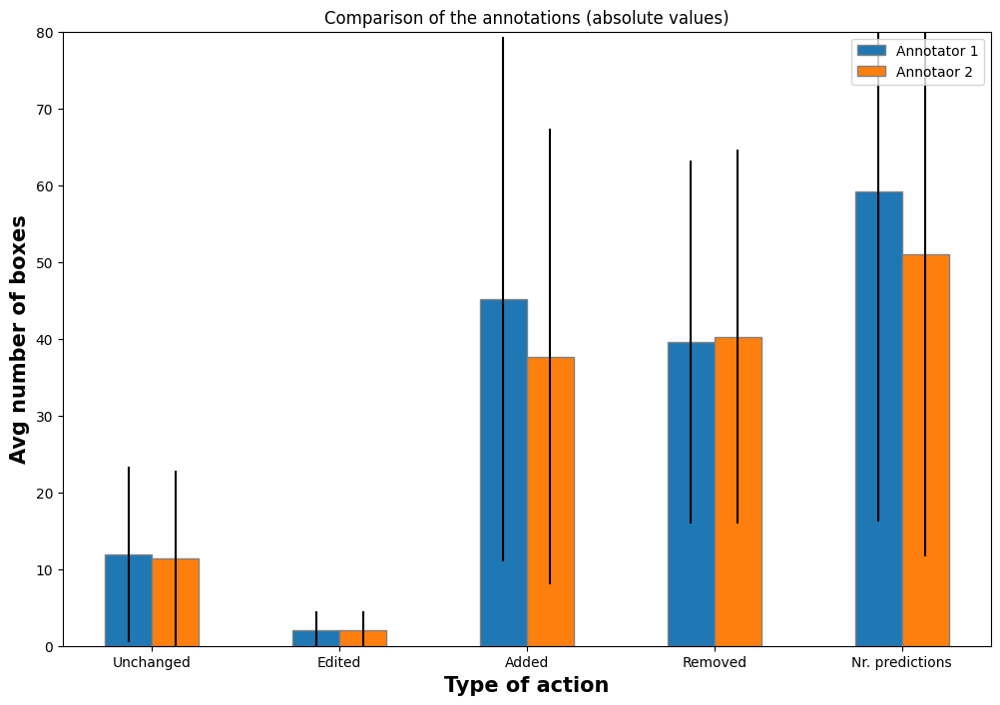

In [ ]:
import numpy as np 
import matplotlib.pyplot as plt 
from statistics import mean, stdev
# set width of bar 
barWidth = 0.25
fig = plt.subplots(figsize =(12, 8)) 

# set height of bar 
ANN_1 = [mean(x) for x in [untouched_1, edited_1, added_1, removed_1, nr_annotated_1]]
ERR_1 = [stdev(x) for x in [untouched_1, edited_1, added_1, removed_1, nr_annotated_1]]
ANN_2 = [mean(x) for x in [untouched_2, edited_2, added_2, removed_2, nr_annotated_2]]
ERR_2 = [stdev(x) for x in [untouched_2, edited_2, added_2, removed_2, nr_annotated_2]]

# Set position of bar on X axis 
br1 = np.arange(len(ANN_1)) 
br2 = [x + barWidth for x in br1] 

# Make the plot
plt.bar(br1, ANN_1, width = barWidth, 
        edgecolor ='grey', label ='Annotator 1', yerr=ERR_1)
plt.bar(br2, ANN_2, width = barWidth, 
        edgecolor ='grey', label ='Annotaor 2', yerr=ERR_2) 

# Adding Xticks 
plt.xlabel('Type of action', fontweight ='bold', fontsize = 15) 
plt.ylabel('Avg number of boxes', fontweight ='bold', fontsize = 15) 
plt.ylim(0, 80)
plt.xticks([r + barWidth/2 for r in br1], 
        ['Unchanged', 'Edited', 'Added', 'Removed', 'Nr. predictions'])

plt.legend()
plt.title("Comparison of the annotations (absolute values)")
plt.show()

[0.17948586294564914, 0.04719721085171854, 0.7733169262026324]
[0.19634465982570906, 0.05310366052743004, 0.7505516796468609]


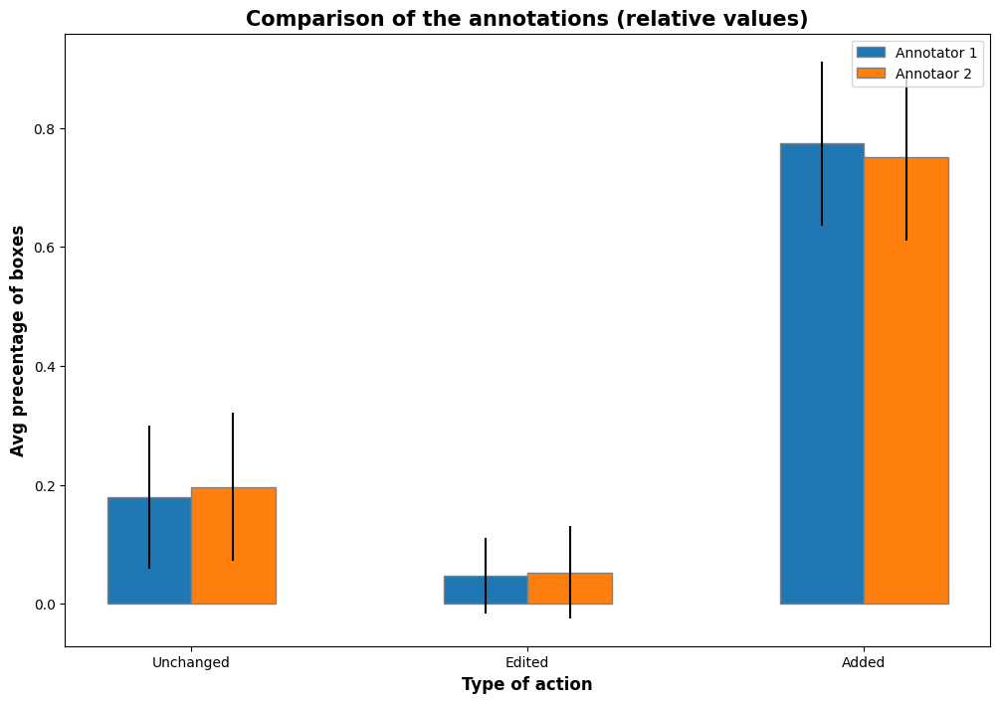

In [ ]:
# set width of bar 
barWidth = 0.25
fig = plt.subplots(figsize =(12, 8)) 

# set height of bar 
ANN_1 = [mean(x) for x in [untoched_1_rel, edited_1_rel, added_1_rel]]
print(ANN_1)
ERR_1 = [stdev(x) for x in [untoched_1_rel, edited_1_rel, added_1_rel]]
ANN_2 = [mean(x) for x in [untoched_2_rel, edited_2_rel, added_2_rel]]
print(ANN_2)
ERR_2 = [stdev(x) for x in [untoched_2_rel, edited_2_rel, added_2_rel]]

# Set position of bar on X axis 
br1 = np.arange(len(ANN_1)) 
br2 = [x + barWidth for x in br1] 

# Make the plot
plt.bar(br1, ANN_1, width = barWidth, 
        edgecolor ='grey', label ='Annotator 1', yerr=ERR_1) 
plt.bar(br2, ANN_2, width = barWidth, 
        edgecolor ='grey', label ='Annotaor 2', yerr=ERR_2) 

# Adding Xticks 
plt.xlabel('Type of action', fontweight ='bold', fontsize = 12) 
plt.ylabel('Avg precentage of boxes', fontweight ='bold', fontsize = 12) 
plt.xticks([r + barWidth/2 for r in br1], 
        ['Unchanged', 'Edited', 'Added'])

plt.legend()
plt.title("Comparison of the annotations (relative values)", fontweight ='bold', fontsize = 15)
plt.show()

## Comapre the two annotators one wrt to the other.

Next we want to avaluate the inter-rater reliability. To do so we compute the precision and recall for varying iou thresholds when considering one of the annotators the ground truth and the opposite.

More specifically, inca se ann1 is the ground turht and ann2 the prediciton, we call:

- **True Positive**: the predictions of ann2 that have been matched to one prediction of ann1 (remark: these associations are unique and reversible).
- **False Positives**: the instances of ann2 that have no matching among the instances from ann1 (the ground truth)
- **False Negatives**: the instances of ann1 (the ground truth) taht have no matching among the instances of ann2

**REMARK**: note that when we invert the ground truth role the TP remanin unchanged (due to the revesibility) and the FP and FN swap.

In [ ]:
from scipy.optimize import linear_sum_assignment

def compute_iou_matrix(bboxes_1, bboxes_2, ):
    # compute the iou matrix
    iou_matrix = np.zeros((len(bboxes_1), len(bboxes_2)))
    for i, box_1 in enumerate(bboxes_1):
        for j, box_2 in enumerate(bboxes_2):
            iou_matrix[i, j] = compute_iou(box_1, box_2)
    return iou_matrix


def instance_matcher(iou_matrix, iou_threshold: float = 0.75):
    # filter out the matches with low iou
    iou_matrix[iou_matrix < iou_threshold] = 0
    # Hungarian algorithm
    row_ind, col_ind = linear_sum_assignment(iou_matrix, maximize=True)
    # fileter out the matches (some of them might be an artifact of the Hungarian algorithm)
    row_ind_threshold = []
    col_ind_threshold = []
    for i, j in zip(row_ind, col_ind):
        if iou_matrix[i, j] >= iou_threshold:
            row_ind_threshold.append(i)
            col_ind_threshold.append(j)
    return row_ind_threshold, col_ind_threshold

In [ ]:
from copy import deepcopy

iou_threshold = np.linspace(0.1, 0.9, 20)

precisions_1 = []
recalls_1 = []
precisions_2 = []
recalls_2 = []

for annotation_path_1, annotation_path_2 in zip(annotations_1_paths, annotations_2_paths):
    if not os.path.exists(annotation_path_1):
        warnings.warn(f"Annotations path {annotation_path_1} does not exist. Skipping the image.")
        continue
    if not os.path.exists(annotation_path_2):
        warnings.warn(f"Annotations path {annotation_path_2} does not exist. Skipping the image.")
        continue

    # load the annotations
    bboxes_annotated_1 = pd.read_csv(annotation_path_1, index_col=0, sep=",")
    bboxes_annotated_1 = bbox_xyxy_to_box(bboxes_annotated_1)
    nr_annotated_1 = len(bboxes_annotated_1)

    bboxes_annotated_2 = pd.read_csv(annotation_path_2, index_col=0, sep=",")
    bboxes_annotated_2 = bbox_xyxy_to_box(bboxes_annotated_2)
    nr_annotated_2 = len(bboxes_annotated_2)
    if nr_annotated_1 == 0 or nr_annotated_2 == 0:
        print(f"One of the annotations is empty. Skipping the image {annotation_path_1}. \nNr. annotated 1: {nr_annotated_1} \nNr. annotated 2: {nr_annotated_2}")
        continue

    # compute the iou matrix
    iou_matrix = compute_iou_matrix(bboxes_annotated_1, bboxes_annotated_2)
    precisions_1_image = []
    recalls_1_image = []
    precisions_2_image = []
    recalls_2_image = []
    for iou_th in iou_threshold:
        row_ind, col_ind = instance_matcher(deepcopy(iou_matrix), iou_th)
        row_ind_2, col_ind_2 = instance_matcher(deepcopy(iou_matrix.T), iou_th)
        pairs = list(zip(row_ind, col_ind))
        pairs_2 = list(zip(col_ind_2, row_ind_2))
        assert len(pairs) == len(pairs_2), "The number of pairs should be equal."
        for pair in pairs:
            assert pair in pairs_2, f"The pairs should be equal. \nPair: \n{pair} \nPairs_2: \n{pairs_2}"
        # compute the true positives
        true_positives = len(row_ind)
        # compute the false positives
        false_positives_1 = len(bboxes_annotated_1) - len(row_ind)
        false_positives_2= len(bboxes_annotated_2) - len(row_ind)
        # compute the false negatives
        false_negatives_1 = len(bboxes_annotated_2) - len(row_ind)
        false_negatives_2 = len(bboxes_annotated_1) - len(row_ind)
        # compute the precision
        precisions_1_image.append(true_positives / (true_positives + false_positives_1))
        precisions_2_image.append(true_positives / (true_positives + false_positives_2))
        # compute the recall
        recalls_1_image.append(true_positives / (true_positives + false_negatives_1))
        recalls_2_image.append(true_positives / (true_positives + false_negatives_2))
    precisions_1.append(precisions_1_image)
    recalls_1.append(recalls_1_image)
    precisions_2.append(precisions_2_image)
    recalls_2.append(recalls_2_image)
precisions_1 = np.array(precisions_1)
print(precisions_1.shape)
recalls_1 = np.array(recalls_1)
precisions_2 = np.array(precisions_2)
recalls_2 = np.array(recalls_2)



One of the annotations is empty. Skipping the image ../dataset/merge_alone_1_corrected_LT/annotations/D223_CTRL_d9/Bortezomib/4x_XY34_Z001_CH4_box.csv. 
Nr. annotated 1: 0 
Nr. annotated 2: 0
(19, 20)


Mean precision Annotator 1: [0.781398   0.781398   0.781398   0.78069625 0.77908705 0.77908705
 0.77908705 0.77698179 0.7766004  0.77383369 0.77105157 0.76169237
 0.7509786  0.74370333 0.72811779 0.71741746 0.68147304 0.63541941
 0.62802385 0.61502288]
Mean recall Annotator 1: [0.86060414 0.86060414 0.86060414 0.8596967  0.85783232 0.85783232
 0.85783232 0.85511    0.85464423 0.85153177 0.8480611  0.83653652
 0.82534777 0.81807394 0.80233685 0.78966429 0.76967756 0.73809208
 0.72949299 0.7161875 ]
Mean precision Annotator 2: [0.86060414 0.86060414 0.86060414 0.8596967  0.85783232 0.85783232
 0.85783232 0.85511    0.85464423 0.85153177 0.8480611  0.83653652
 0.82534777 0.81807394 0.80233685 0.78966429 0.76967756 0.73809208
 0.72949299 0.7161875 ]
Mean recall Annotator 2: [0.781398   0.781398   0.781398   0.78069625 0.77908705 0.77908705
 0.77908705 0.77698179 0.7766004  0.77383369 0.77105157 0.76169237
 0.7509786  0.74370333 0.72811779 0.71741746 0.68147304 0.63541941
 0.62802385 0.6150

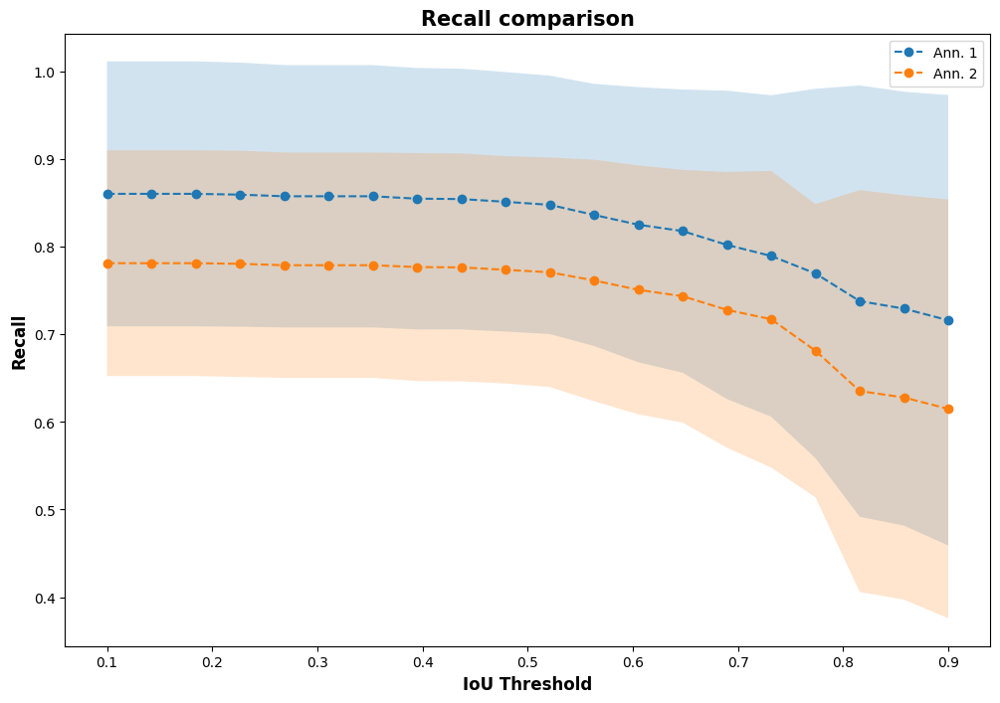

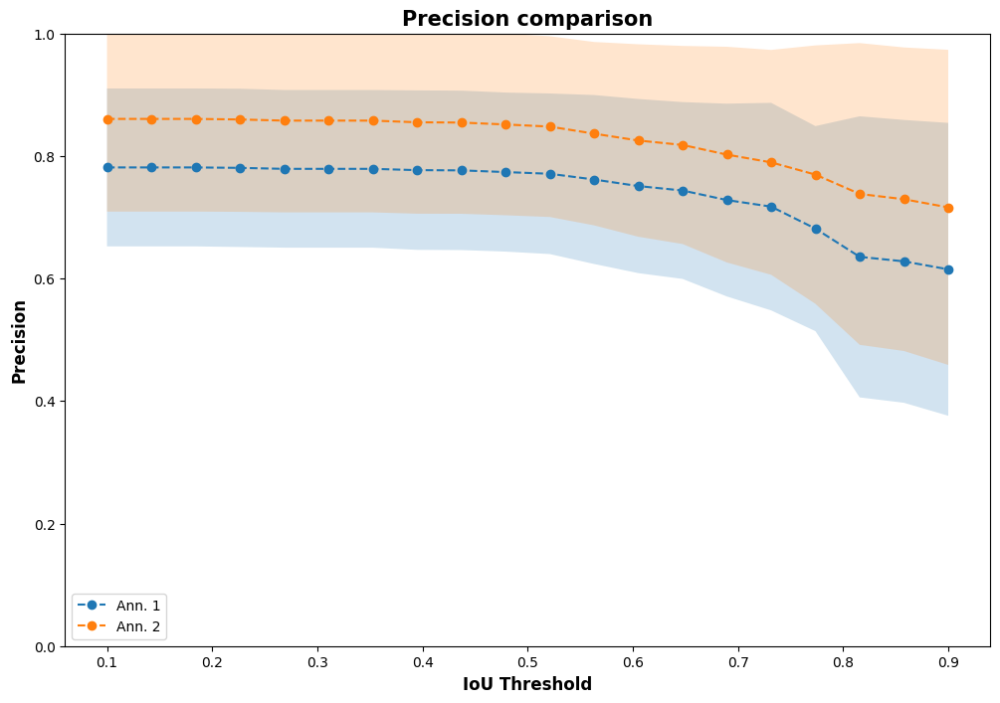

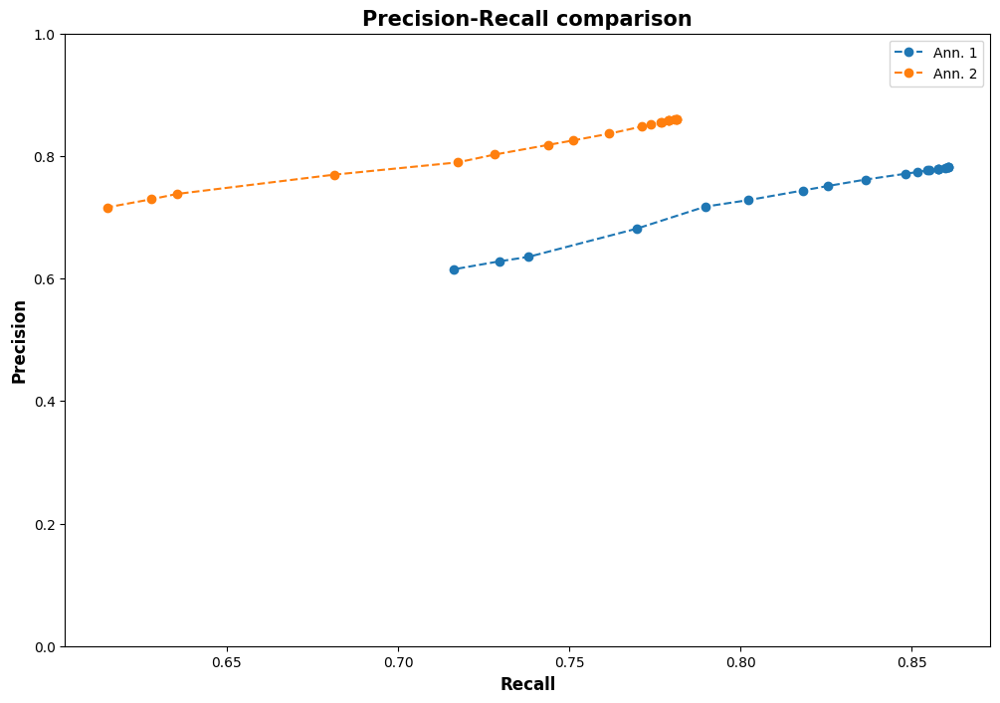

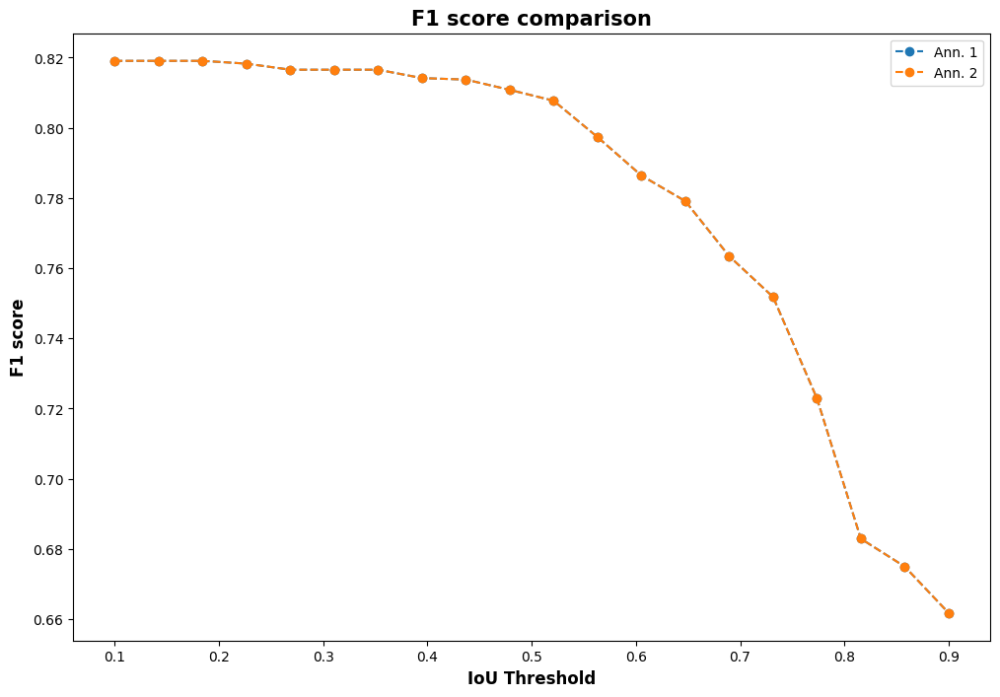

In [ ]:
recalls_1_mean = np.mean(recalls_1, axis=0)
recalls_1_std = np.std(recalls_1, axis=0)
precisions_1_mean = np.mean(precisions_1, axis=0)
precisions_1_std = np.std(precisions_1, axis=0)
recalls_2_mean = np.mean(recalls_2, axis=0)
recalls_2_std = np.std(recalls_2, axis=0)
precisions_2_mean = np.mean(precisions_2, axis=0)
precisions_2_std = np.std(precisions_2, axis=0)

print(f"Mean precision Annotator 1: {precisions_1_mean}")
print(f"Mean recall Annotator 1: {recalls_1_mean}")
print(f"Mean precision Annotator 2: {precisions_2_mean}")
print(f"Mean recall Annotator 2: {recalls_2_mean}")

# recall plot
fig = plt.subplots(figsize =(12, 8)) 
plt.plot(iou_threshold, recalls_1_mean, label="Ann. 1", marker="o", linestyle="--")
plt.fill_between(iou_threshold, recalls_1_mean - recalls_1_std, recalls_1_mean + recalls_1_std, alpha=0.2)
plt.plot(iou_threshold, recalls_2_mean, label="Ann. 2", marker="o", linestyle="--")
plt.fill_between(iou_threshold, recalls_2_mean - recalls_2_std, recalls_2_mean + recalls_2_std, alpha=0.2)
plt.xlabel("IoU Threshold", fontweight ='bold', fontsize = 12)
plt.ylabel("Recall", fontweight ='bold', fontsize = 12)
plt.title("Recall comparison", fontweight ='bold', fontsize = 15)
plt.legend()
plt.show()

# precision plot
fig = plt.subplots(figsize =(12, 8)) 
plt.plot(iou_threshold, precisions_1_mean, label="Ann. 1", marker="o", linestyle="--")
plt.fill_between(iou_threshold, precisions_1_mean - precisions_1_std, precisions_1_mean + precisions_1_std, alpha=0.2)
plt.plot(iou_threshold, precisions_2_mean, label="Ann. 2", marker="o", linestyle="--")
plt.fill_between(iou_threshold, precisions_2_mean - precisions_2_std, precisions_2_mean + precisions_2_std, alpha=0.2)
plt.xlabel("IoU Threshold", fontweight ='bold', fontsize = 12)
plt.ylabel("Precision", fontweight ='bold', fontsize = 12)
plt.title("Precision comparison", fontweight ='bold', fontsize = 15)
plt.legend()
plt.ylim(0, 1)
plt.show()

# precision_recall_plot

fig = plt.subplots(figsize =(12, 8))
plt.plot(recalls_1_mean, precisions_1_mean, label="Ann. 1", marker="o", linestyle="--")
plt.plot(recalls_2_mean, precisions_2_mean, label="Ann. 2", marker="o", linestyle="--")
plt.xlabel("Recall", fontweight ='bold', fontsize = 12)
plt.ylabel("Precision", fontweight ='bold', fontsize = 12)
plt.title("Precision-Recall comparison", fontweight ='bold', fontsize = 15)
plt.legend()
plt.ylim(0, 1)
plt.show()

# F1 score
f1_1 = 2 * precisions_1_mean * recalls_1_mean / (precisions_1_mean + recalls_1_mean)
f1_2 = 2 * precisions_2_mean * recalls_2_mean / (precisions_2_mean + recalls_2_mean)
fig = plt.subplots(figsize =(12, 8))
plt.plot(iou_threshold, f1_1, label="Ann. 1", marker="o", linestyle="--")
plt.plot(iou_threshold, f1_2, label="Ann. 2", marker="o", linestyle="--")
plt.xlabel("IoU Threshold", fontweight ='bold', fontsize = 12)
plt.ylabel("F1 score", fontweight ='bold', fontsize = 12)
plt.title("F1 score comparison", fontweight ='bold', fontsize = 15)
plt.legend()
plt.show()



# Investigate the size distribution of the prefictions

In [ ]:


iou_threshold = np.linspace(0.1, 0.9, 10)

sizes_1 = []
sizes_2 = []

for annotation_path_1, annotation_path_2 in zip(annotations_1_paths, annotations_2_paths):
    if not os.path.exists(annotation_path_1):
        warnings.warn(f"Annotations path {annotation_path_1} does not exist. Skipping the image.")
        continue
    if not os.path.exists(annotation_path_2):
        warnings.warn(f"Annotations path {annotation_path_2} does not exist. Skipping the image.")
        continue

    # load the annotations
    bboxes_annotated_1 = pd.read_csv(annotation_path_1, index_col=0, sep=",")
    bboxes_annotated_1 = bbox_xyxy_to_box(bboxes_annotated_1)

    bboxes_annotated_2 = pd.read_csv(annotation_path_2, index_col=0, sep=",")
    bboxes_annotated_2 = bbox_xyxy_to_box(bboxes_annotated_2)


    sizes_1_image = []
    sizes_2_image = []

    for bbox in bboxes_annotated_1:
        sizes_1_image.append(bbox.diameter())

    for bbox in bboxes_annotated_2:
        sizes_2_image.append(bbox.diameter())
    
    sizes_1.append(sizes_1_image)
    sizes_2.append(sizes_2_image)
    

In [ ]:
print(precisions_2.shape)
print(len(annotations_1_paths))

(19, 20)
20


Plot the distribution of the sizes

IDEA clould plot the ones having the most significant difference in distribution... -> remember to correct the test 

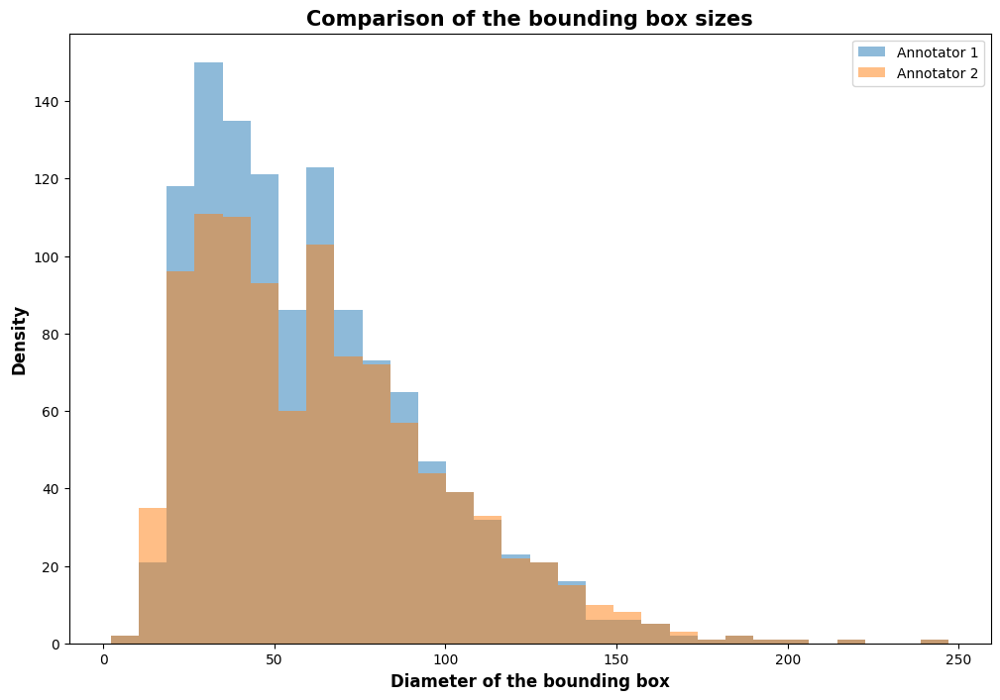

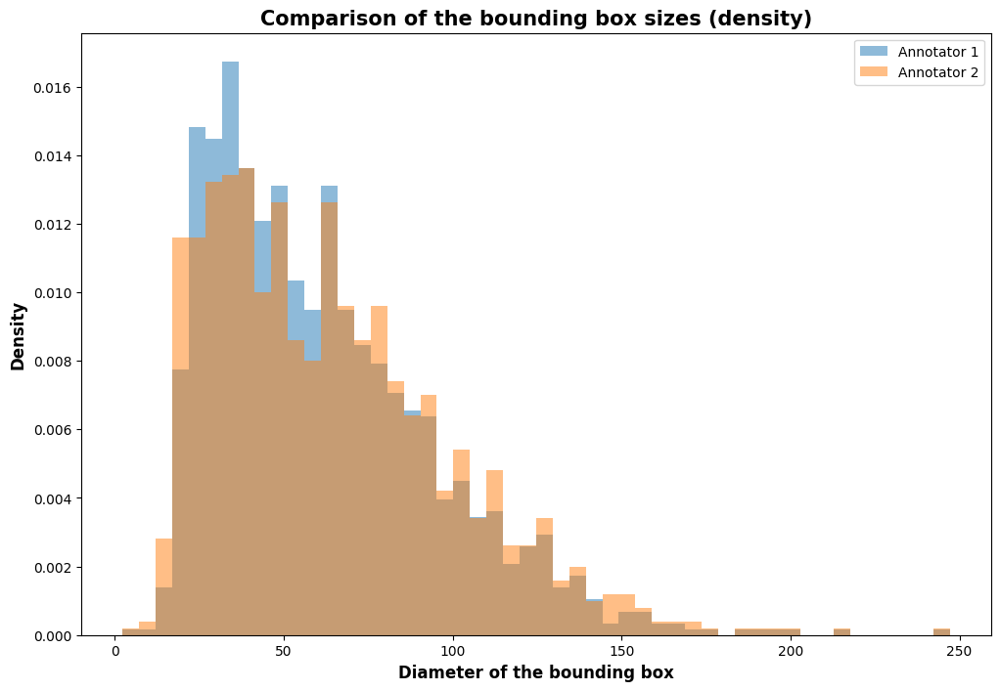

In [ ]:
sizes_1_flat = [item for sublist in sizes_1 for item in sublist]
sizes_2_flat = [item for sublist in sizes_2 for item in sublist]

fig = plt.subplots(figsize =(12, 8))
plt.hist(sizes_1_flat, bins=30, alpha=0.5, label="Annotator 1")
plt.hist(sizes_2_flat, bins=30, alpha=0.5, label="Annotator 2")
plt.xlabel("Diameter of the bounding box", fontweight ='bold', fontsize = 12)
plt.ylabel("Density", fontweight ='bold', fontsize = 12)
plt.title("Comparison of the bounding box sizes", fontweight ='bold', fontsize = 15)
plt.legend()
plt.show()

fig = plt.subplots(figsize =(12, 8))
plt.hist(sizes_1_flat, bins=50, alpha=0.5, label="Annotator 1", density=True)
plt.hist(sizes_2_flat, bins=50, alpha=0.5, label="Annotator 2", density=True)
plt.xlabel("Diameter of the bounding box", fontweight ='bold', fontsize = 12)
plt.ylabel("Density", fontweight ='bold', fontsize = 12)
plt.title("Comparison of the bounding box sizes (density)", fontweight ='bold', fontsize = 15)
plt.legend()
plt.show()

../dataset/merge_alone_1_corrected_LT/images/D223_CTRL_d9/Bortezomib/4x_XY34_Z001_CH4.tif


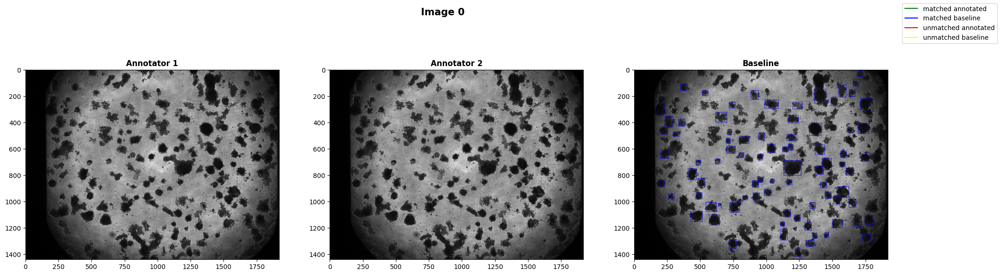

../dataset/merge_alone_1_corrected_LT/images/D223_CTRL_d9/DMSO/4x_XY129_Z001_CH4.tif


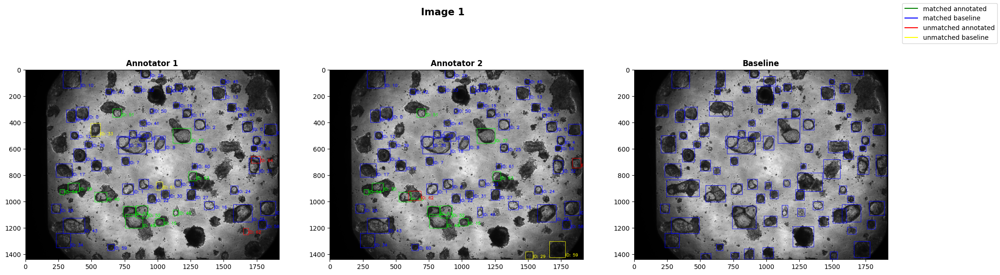

../dataset/merge_alone_1_corrected_LT/images/D223_CTRL_d9/Intermediate_response/4x_XY183_Z001_CH4.tif


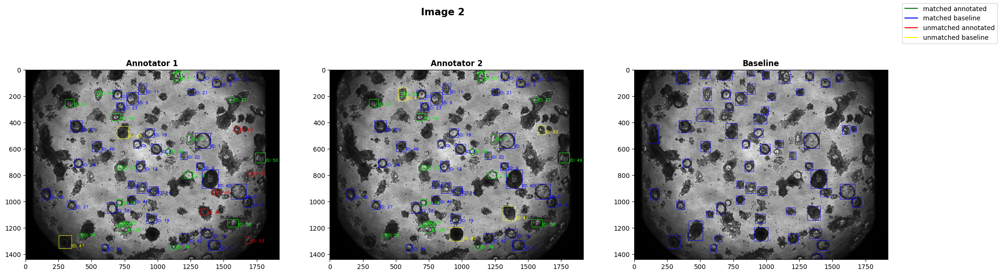

../dataset/merge_alone_1_corrected_LT/images/D223_CTRL_d9/Intermediate_response/4x_XY202_Z001_CH4.tif


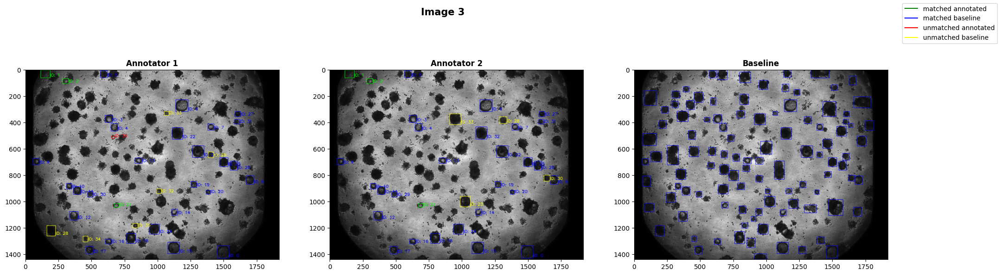

../dataset/merge_alone_1_corrected_LT/images/D223_CTRL_d9/Intermediate_response/4x_XY79_Z001_CH4.tif


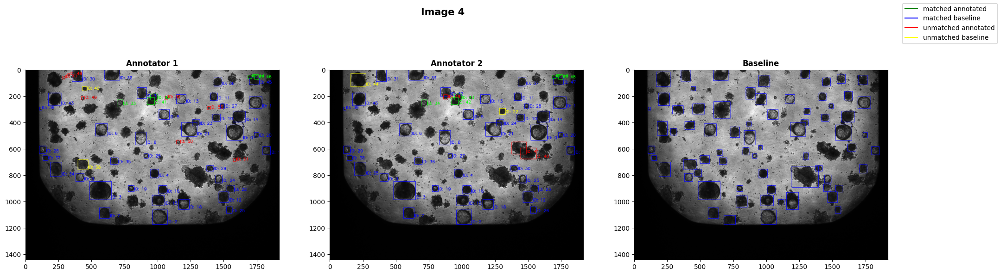

../dataset/merge_alone_1_corrected_LT/images/D223_CTRL_d9/Intermediate_response/4x_XY39_Z001_CH4.tif


/Users/francesco/Documents/Work/Colorectal-Cancer-Organoids-Detection/src/utils/annotation_utils.py:78: RuntimeWarning: overflow encountered in scalar multiply
  return (self.right - self.left) * (self.bottom - self.top)


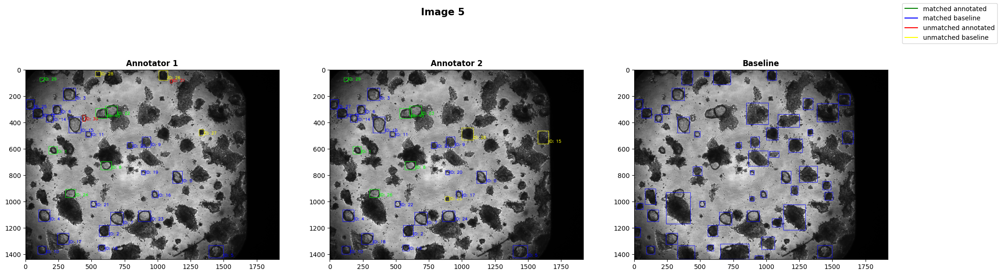

../dataset/merge_alone_1_corrected_LT/images/D223_CTRL_d9/Intermediate_response/4x_XY127_Z001_CH4.tif


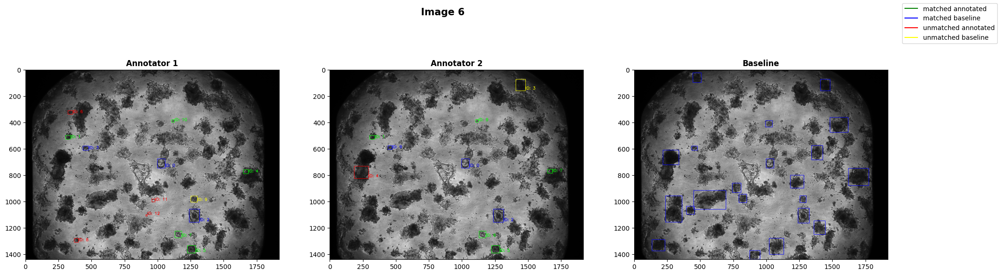

../dataset/merge_alone_1_corrected_LT/images/D284_DMSO_d9/Intermediate_response/4x_XY113_Z001_CH4.tif


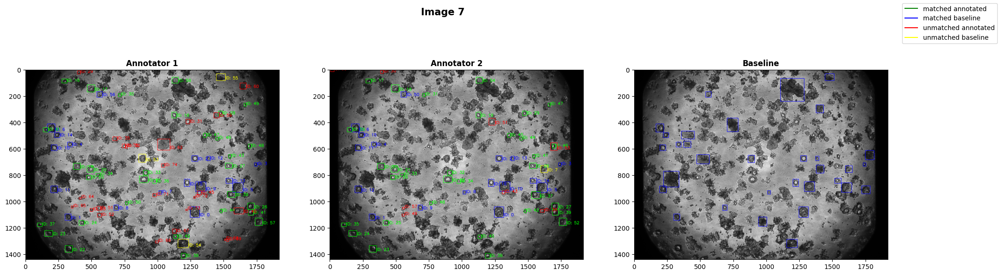

../dataset/merge_alone_1_corrected_LT/images/D284_DMSO_d9/Intermediate_response/4x_XY106_Z001_CH4.tif


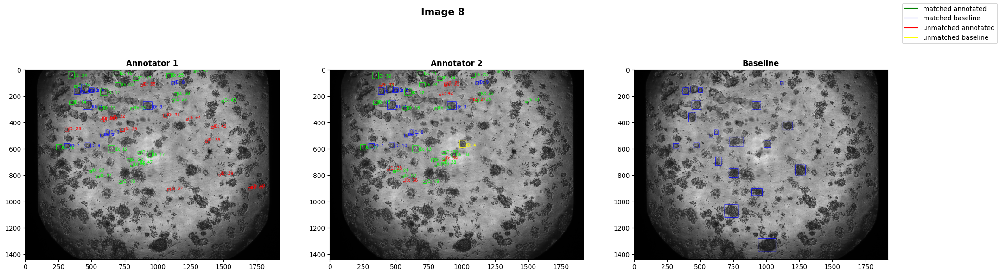

../dataset/merge_alone_1_corrected_LT/images/D284_DMSO_d9/Intermediate_response/4x_XY55_Z001_CH4.tif


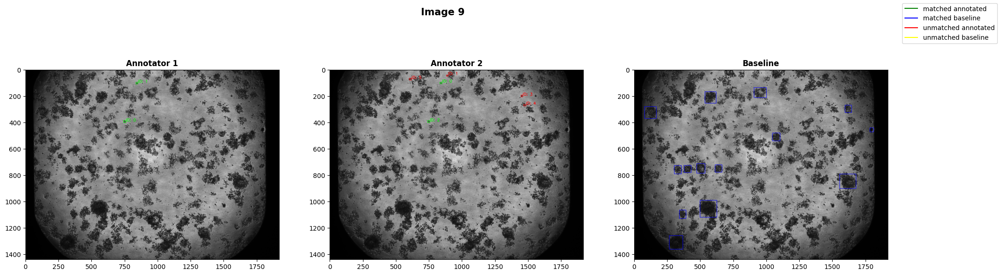

../dataset/merge_alone_1_corrected_LT/images/D284_DMSO_d9/Intermediate_response/4x_XY176_Z001_CH4.tif


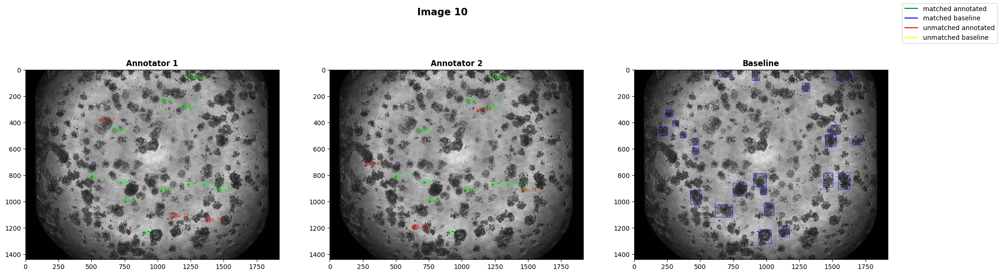

../dataset/merge_alone_1_corrected_LT/images/D284_DMSO_d9/Intermediate_response/4x_XY321_Z001_CH4.tif


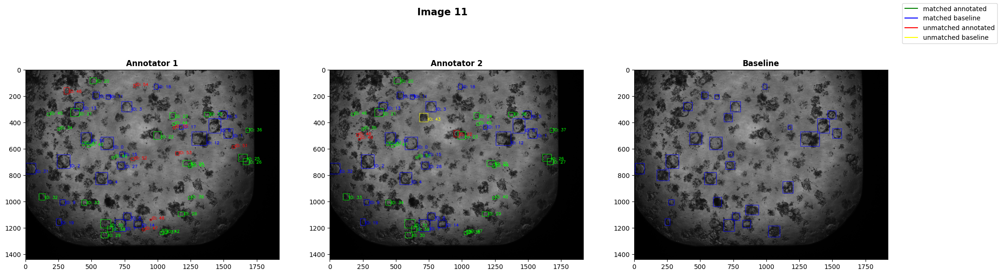

../dataset/merge_alone_1_corrected_LT/images/D284_TREAT_d9/DMSO/4x_XY254_Z001_CH4.tif


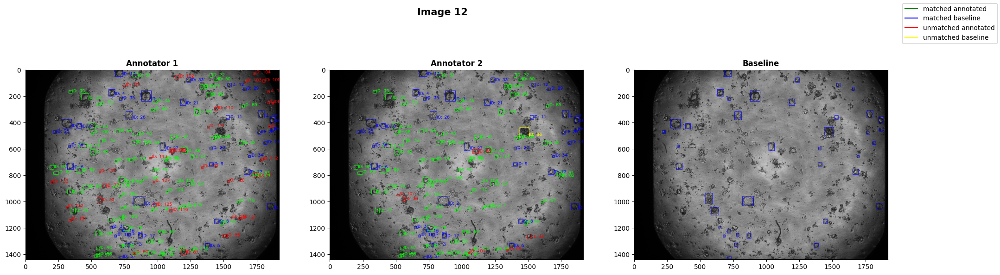

../dataset/merge_alone_1_corrected_LT/images/D284_TREAT_d9/Intermediate_response/4x_XY267_Z001_CH4.tif


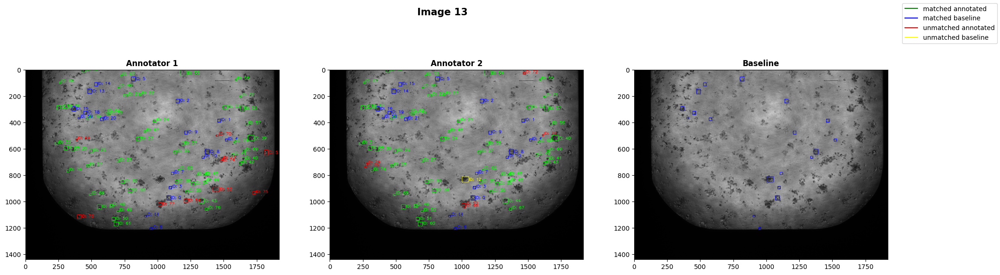

../dataset/merge_alone_1_corrected_LT/images/D131_CTRL_d9/DMSO/10x_XY169_Z001_CH4.tif


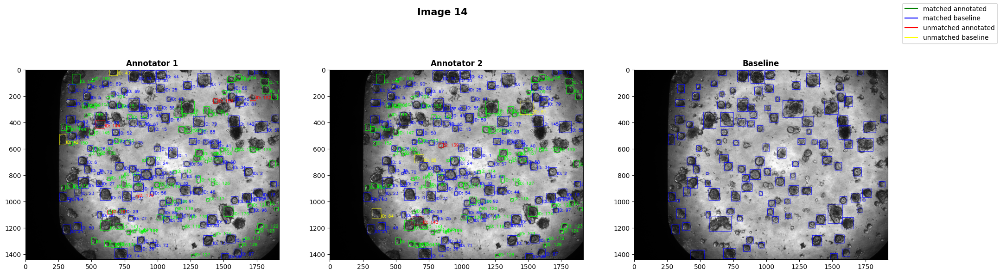

../dataset/merge_alone_1_corrected_LT/images/D131_CTRL_d9/Intermediate_response/10x_XY92_Z001_CH4.tif


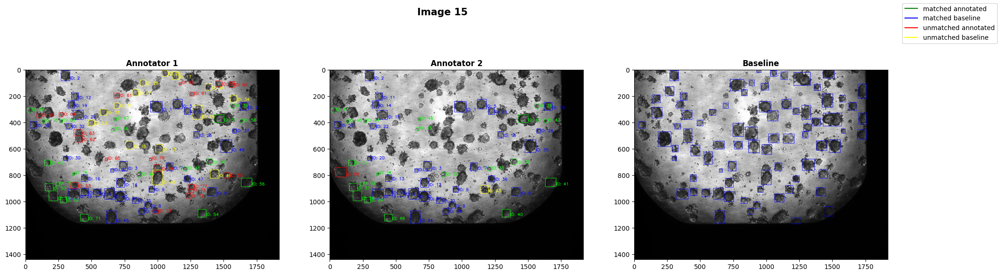

../dataset/merge_alone_1_corrected_LT/images/D131_CTRL_d9/Intermediate_response/10x_XY154_Z001_CH4.tif


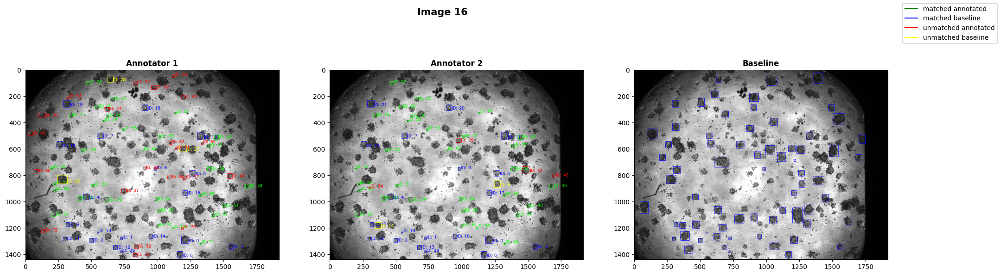

../dataset/merge_alone_1_corrected_LT/images/D131_CTRL_d9/Intermediate_response/10x_XY109_Z001_CH4.tif


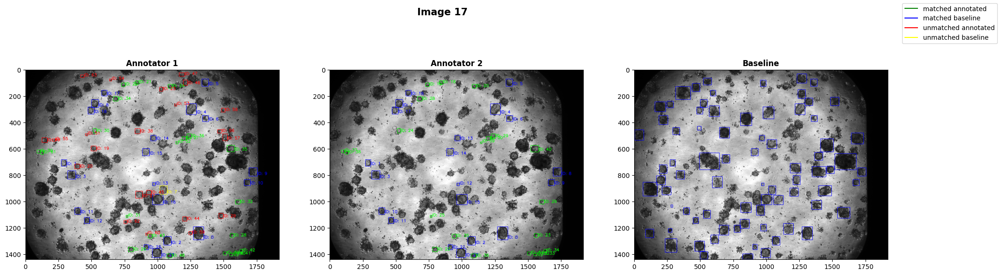

../dataset/merge_alone_1_corrected_LT/images/D131_CTRL_d9/Intermediate_response/10x_XY133_Z001_CH4.tif


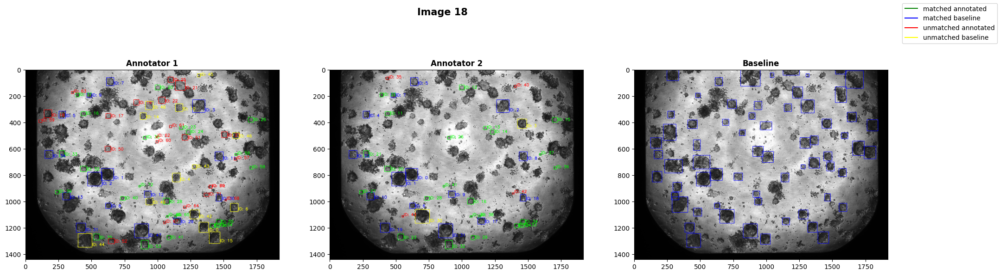

../dataset/merge_alone_1_corrected_LT/images/D131_CTRL_d9/Intermediate_response/10x_XY150_Z001_CH4.tif


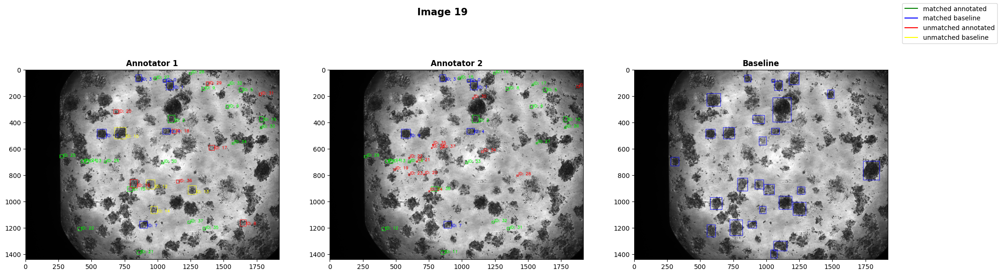

In [ ]:
from copy import deepcopy
import cv2
from matplotlib.lines import Line2D

iou_threshold = 0.5
predictions = pickle.load(open("predictions.pkl", "rb"))

id = 0
for annotation_path_1, annotation_path_2, (image_norm, meta), bbxes_predicitons in zip(annotations_1_paths, annotations_2_paths, inference_ds, predictions):
    if not os.path.exists(annotation_path_1):
        warnings.warn(f"Annotations path {annotation_path_1} does not exist. Skipping the image.")
        continue
    if not os.path.exists(annotation_path_2):
        warnings.warn(f"Annotations path {annotation_path_2} does not exist. Skipping the image.")
        continue

    # load the annotations
    bboxes_annotated_1 = pd.read_csv(annotation_path_1, index_col=0, sep=",")
    bboxes_annotated_1 = bbox_xyxy_to_box(bboxes_annotated_1)
    nr_annotated_1 = len(bboxes_annotated_1)

    bboxes_annotated_2 = pd.read_csv(annotation_path_2, index_col=0, sep=",")
    bboxes_annotated_2 = bbox_xyxy_to_box(bboxes_annotated_2)
    nr_annotated_2 = len(bboxes_annotated_2)

    # compute the iou matrix
    iou_matrix = compute_iou_matrix(bboxes_annotated_1, bboxes_annotated_2)
    # print("Intersection over union matrix")
    # for i in range(iou_matrix.shape[0]):
    #     for j in range(iou_matrix.shape[1]):
    #         if iou_matrix[i, j] > 0:
    #             print(f"ID: {i} - {j}: {iou_matrix[i, j]}")
    true_positives_1, true_positives_2 = instance_matcher(deepcopy(iou_matrix), iou_threshold)

    # print("True positives")
    # for i, j in zip(true_positives_1, true_positives_2):
    #     print(f"ID: {i} - {j}: {compute_iou(bboxes_annotated_1[i], bboxes_annotated_2[j])}")        
    # compute the false positives
    false_positives_1 = [i for i in range(len(bboxes_annotated_1)) if i not in true_positives_1]
    false_positives_2 = [i for i in range(len(bboxes_annotated_2)) if i not in true_positives_2]

    # load the image
    image_path = meta["path"]
    print(image_path)
    image_1 = cv2.imread(image_path)
    image_2 = cv2.imread(image_path)
    image_3 = cv2.imread(image_path)
    # draw the true positives from the baseline in blue and gree the ones from the annotator
    def from_baseline(bbox, bboes_prediction):
        for b in bboes_prediction:
            if compute_iou(bbox, b) >= 0.5:
                return True
        return False
    
    for bbox in bbxes_predicitons:
        cv2.rectangle(image_3, (bbox.right, bbox.top), (bbox.left, bbox.bottom), (0, 0, 255), 2)

    for i in true_positives_1:
        bbox = bboxes_annotated_1[i]
        color = (0, 0, 255) if from_baseline(bbox, bbxes_predicitons) else (0, 255, 0)
        cv2.rectangle(image_1, (bbox.right, bbox.top), (bbox.left, bbox.bottom), color, 2)
        cv2.putText(image_1, f"ID: {i}", (bbox.right, bbox.bottom-10), cv2.FONT_HERSHEY_SIMPLEX, 1, color, 2)
    for i in true_positives_2:
        bbox = bboxes_annotated_2[i]
        color =  (0, 0, 255) if from_baseline(bbox, bbxes_predicitons) else (0, 255, 0)
        cv2.rectangle(image_2, (bbox.right, bbox.top), (bbox.left, bbox.bottom), color, 2)
        cv2.putText(image_2, f"ID: {i}", (bbox.right, bbox.bottom-10), cv2.FONT_HERSHEY_SIMPLEX, 1, color, 2)

    # draw the false positives in red
    for i in false_positives_1:
        bbox = bboxes_annotated_1[i]
        color = (255, 255, 0) if from_baseline(bbox, bbxes_predicitons) else (255, 0, 0)
        cv2.rectangle(image_1, (bbox.right, bbox.top), (bbox.left, bbox.bottom), color, 2)
        cv2.putText(image_1, f"ID: {i}", (bbox.right, bbox.bottom-10), cv2.FONT_HERSHEY_SIMPLEX, 1, color, 2)
    for i in false_positives_2:
        bbox = bboxes_annotated_2[i]
        color = (255, 255, 0) if from_baseline(bbox, bbxes_predicitons) else (255, 0, 0)
        cv2.rectangle(image_2, (bbox.right, bbox.top), (bbox.left, bbox.bottom), color, 2)
        cv2.putText(image_2, f"ID: {i}", (bbox.right, bbox.bottom-10), cv2.FONT_HERSHEY_SIMPLEX, 1, color, 2)
    fig, ax = plt.subplots(1, 3, figsize= (24, 7))
    ax[0].imshow(image_1)
    ax[0].set_title("Annotator 1", fontweight ='bold', fontsize = 12)
    ax[1].imshow(image_2)
    ax[1].set_title("Annotator 2", fontweight ='bold', fontsize = 12)
    ax[2].imshow(image_3)
    ax[2].set_title("Baseline", fontweight ='bold', fontsize = 12)
    fig.suptitle(f"Image {id}", fontweight ='bold', fontsize = 15)
    line_green  = Line2D([0], [0], label='matched annotated', color='green')
    line_blue = Line2D([0], [0], label='matched baseline', color='blue')
    line_red = Line2D([0], [0], label='unmatched annotated', color='red')
    line_yellow = Line2D([0], [0], label='unmatched baseline', color='yellow')
    fig.legend(handles=[line_green, line_blue, line_red, line_yellow])
    plt.show()


    
    id += 1
    


../dataset/merge_alone_1_corrected_LT/images/D223_CTRL_d9/Bortezomib/4x_XY34_Z001_CH4.tif


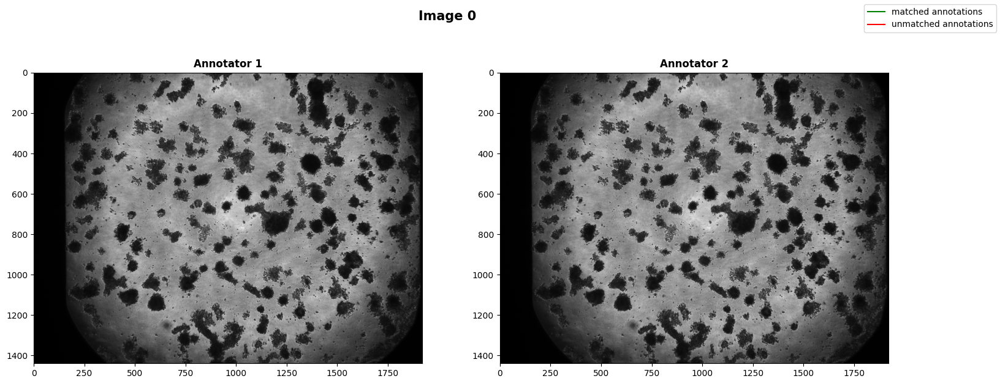

../dataset/merge_alone_1_corrected_LT/images/D223_CTRL_d9/DMSO/4x_XY129_Z001_CH4.tif


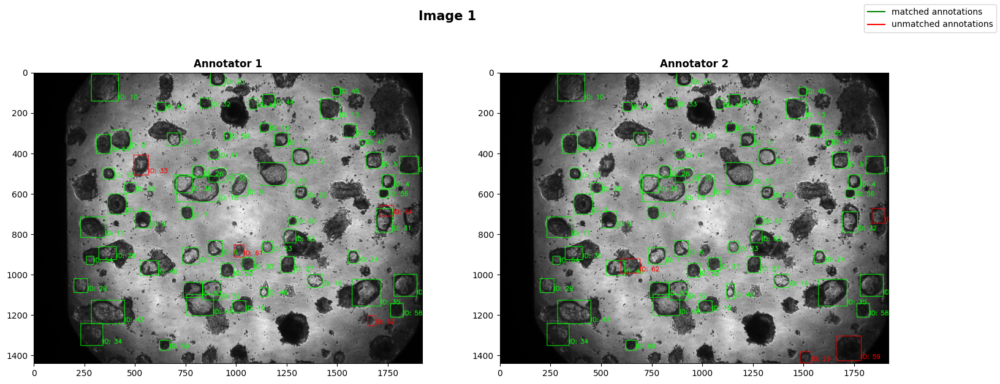

../dataset/merge_alone_1_corrected_LT/images/D223_CTRL_d9/Intermediate_response/4x_XY183_Z001_CH4.tif


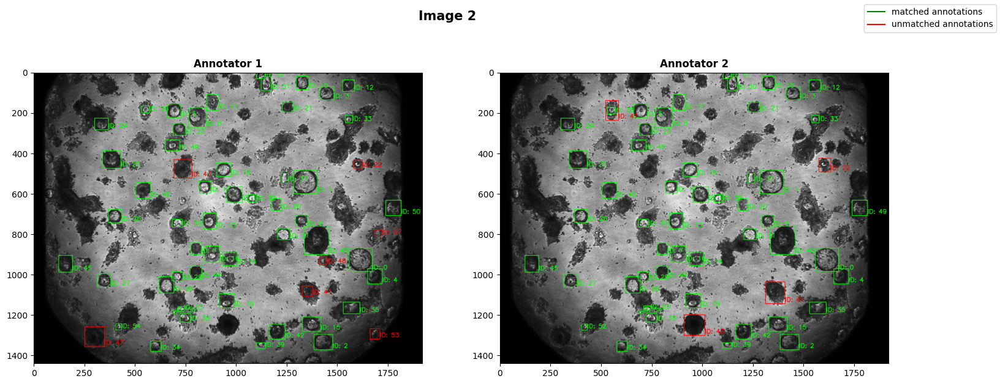

../dataset/merge_alone_1_corrected_LT/images/D223_CTRL_d9/Intermediate_response/4x_XY202_Z001_CH4.tif


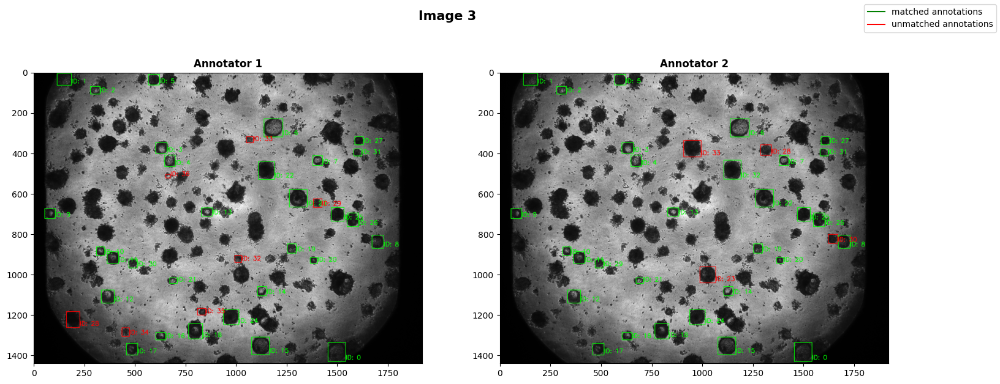

../dataset/merge_alone_1_corrected_LT/images/D223_CTRL_d9/Intermediate_response/4x_XY79_Z001_CH4.tif


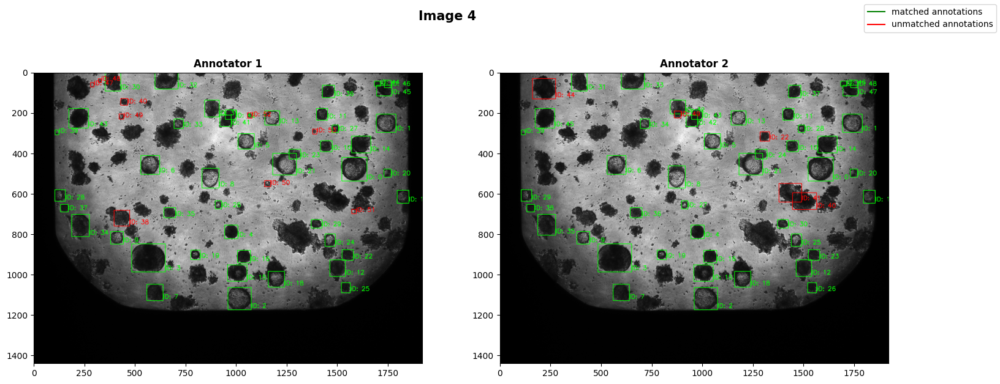

../dataset/merge_alone_1_corrected_LT/images/D223_CTRL_d9/Intermediate_response/4x_XY39_Z001_CH4.tif


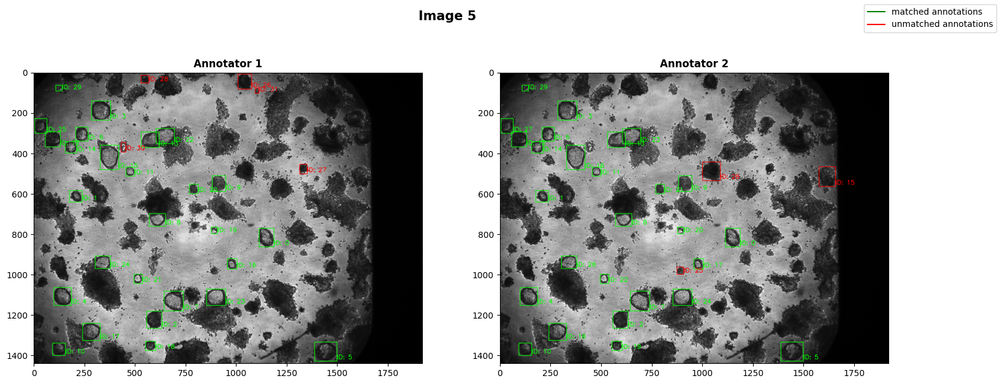

../dataset/merge_alone_1_corrected_LT/images/D223_CTRL_d9/Intermediate_response/4x_XY127_Z001_CH4.tif


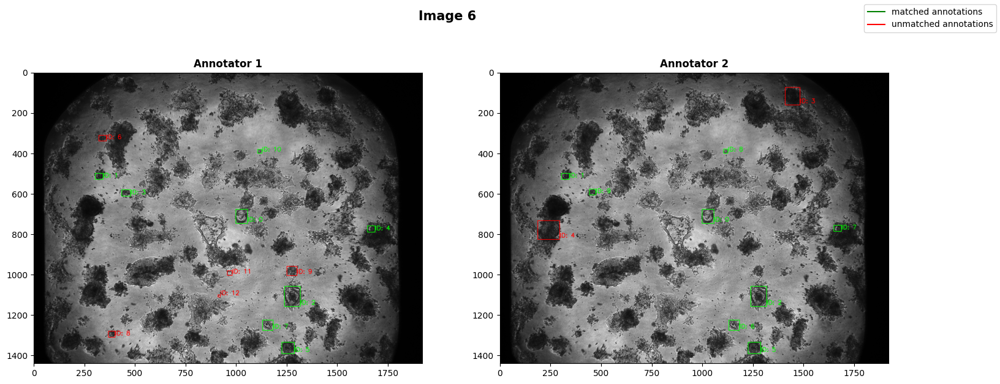

../dataset/merge_alone_1_corrected_LT/images/D284_DMSO_d9/Intermediate_response/4x_XY113_Z001_CH4.tif


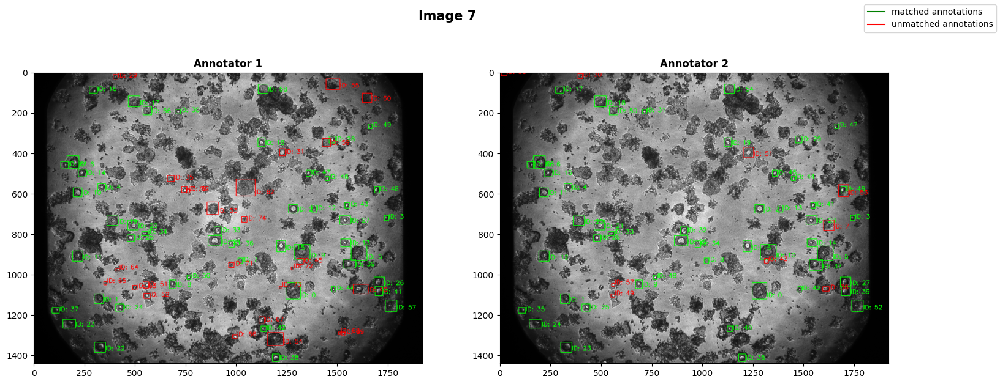

../dataset/merge_alone_1_corrected_LT/images/D284_DMSO_d9/Intermediate_response/4x_XY106_Z001_CH4.tif


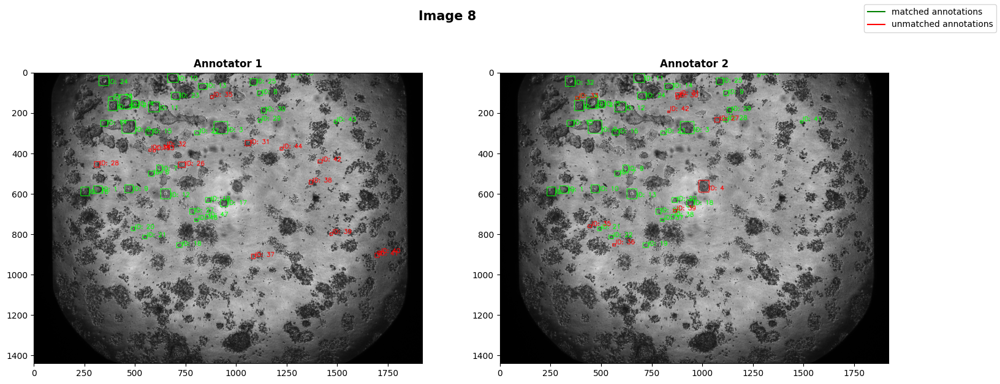

../dataset/merge_alone_1_corrected_LT/images/D284_DMSO_d9/Intermediate_response/4x_XY55_Z001_CH4.tif


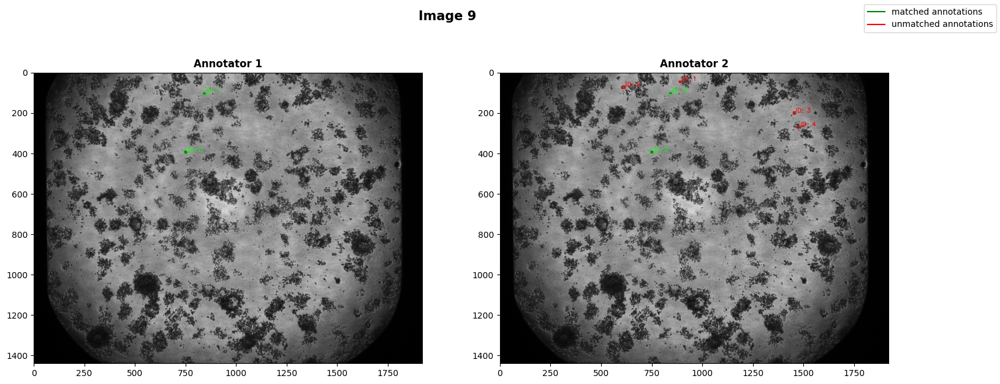

../dataset/merge_alone_1_corrected_LT/images/D284_DMSO_d9/Intermediate_response/4x_XY176_Z001_CH4.tif


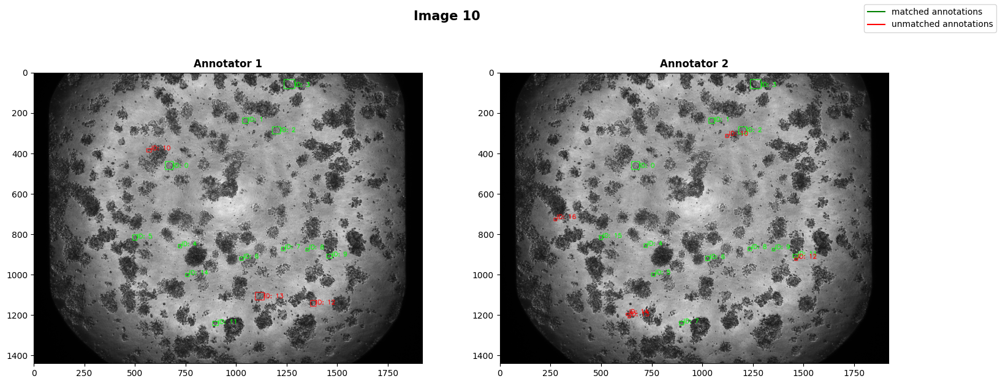

../dataset/merge_alone_1_corrected_LT/images/D284_DMSO_d9/Intermediate_response/4x_XY321_Z001_CH4.tif


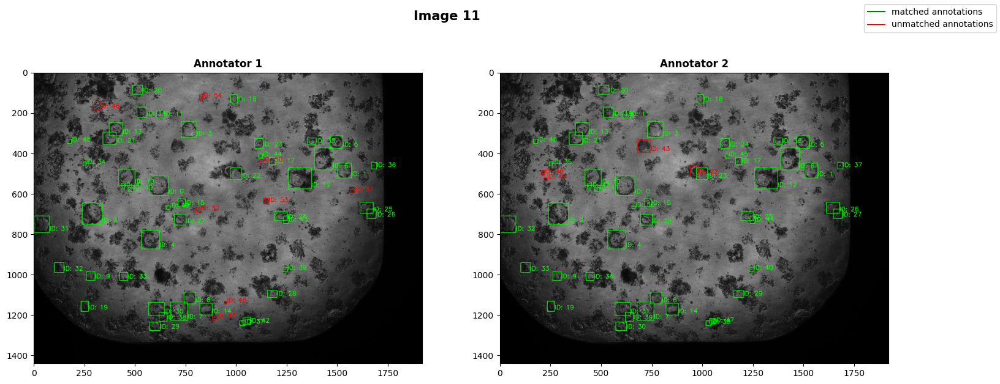

../dataset/merge_alone_1_corrected_LT/images/D284_TREAT_d9/DMSO/4x_XY254_Z001_CH4.tif


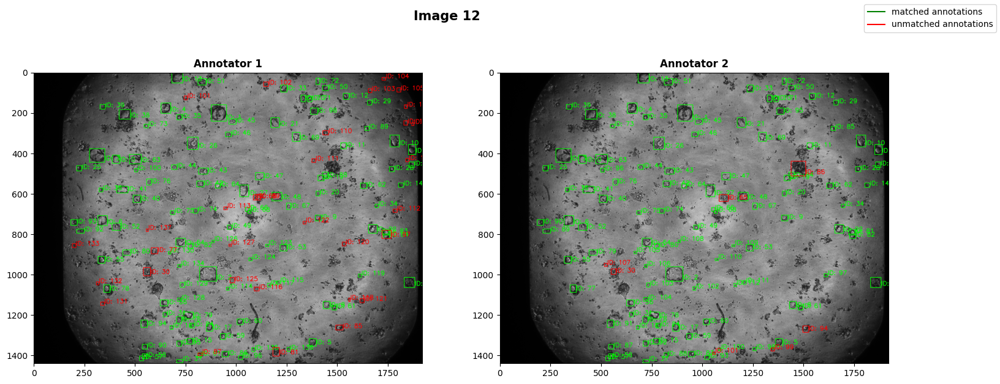

../dataset/merge_alone_1_corrected_LT/images/D284_TREAT_d9/Intermediate_response/4x_XY267_Z001_CH4.tif


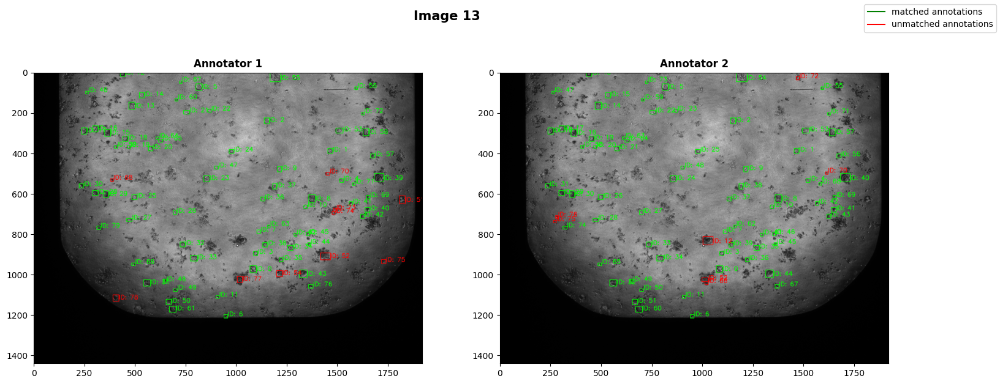

../dataset/merge_alone_1_corrected_LT/images/D131_CTRL_d9/DMSO/10x_XY169_Z001_CH4.tif


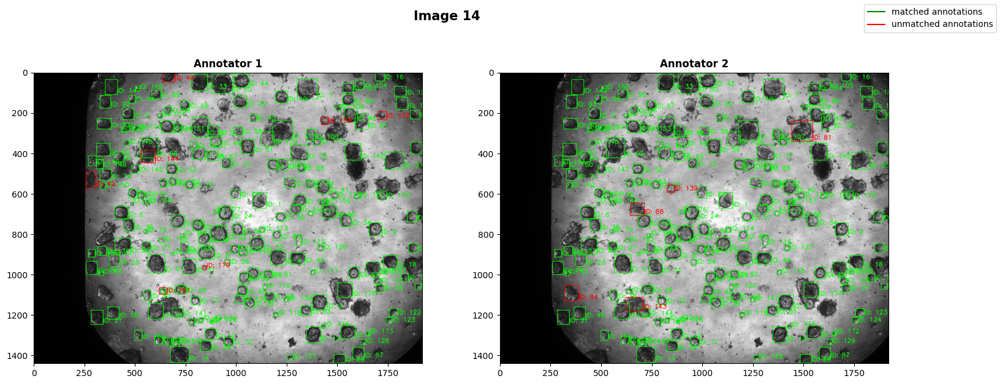

../dataset/merge_alone_1_corrected_LT/images/D131_CTRL_d9/Intermediate_response/10x_XY92_Z001_CH4.tif


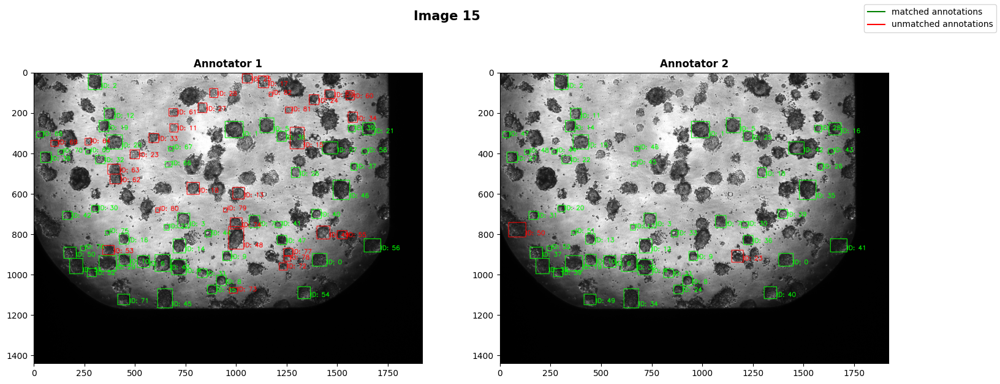

../dataset/merge_alone_1_corrected_LT/images/D131_CTRL_d9/Intermediate_response/10x_XY154_Z001_CH4.tif


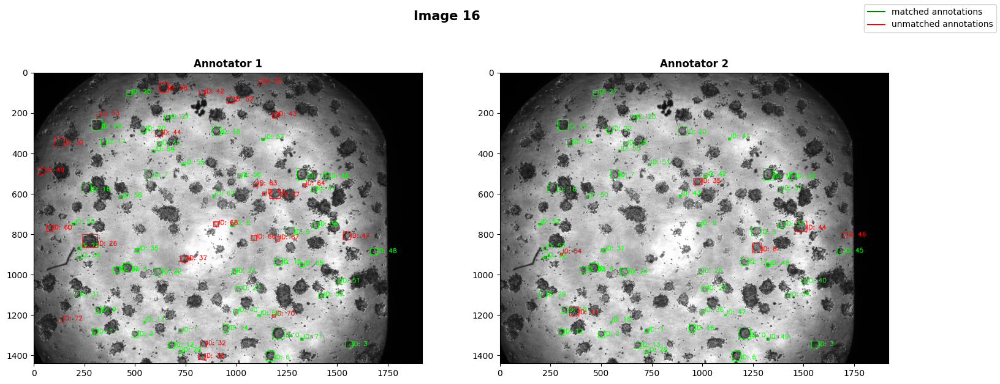

../dataset/merge_alone_1_corrected_LT/images/D131_CTRL_d9/Intermediate_response/10x_XY109_Z001_CH4.tif


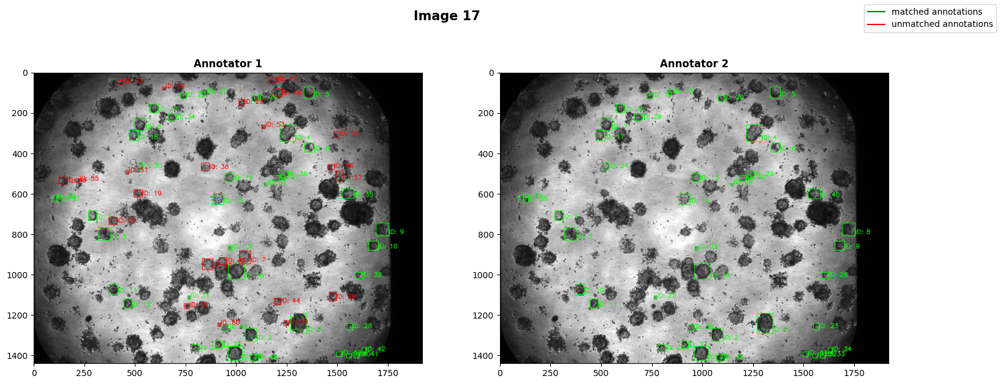

../dataset/merge_alone_1_corrected_LT/images/D131_CTRL_d9/Intermediate_response/10x_XY133_Z001_CH4.tif


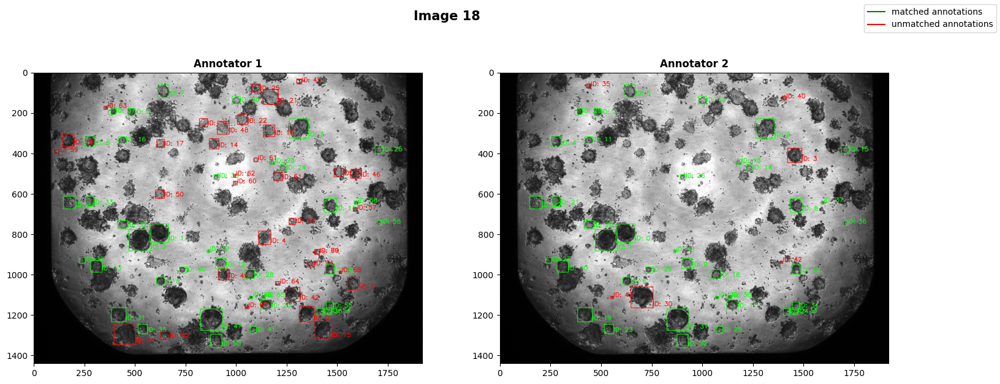

../dataset/merge_alone_1_corrected_LT/images/D131_CTRL_d9/Intermediate_response/10x_XY150_Z001_CH4.tif


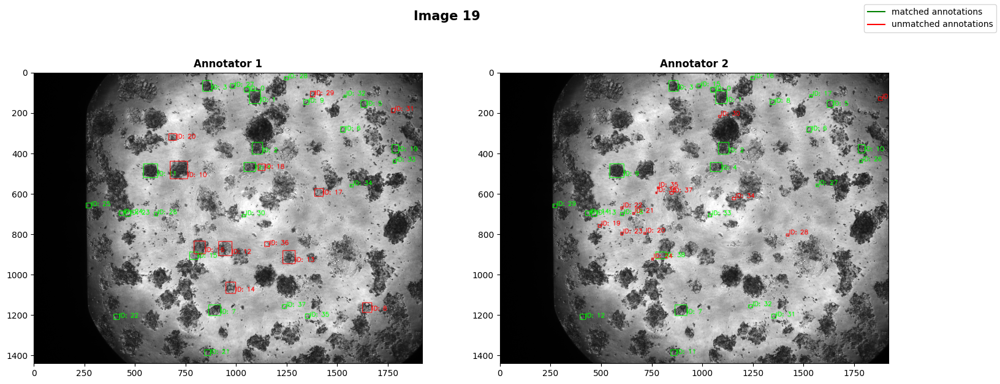

In [ ]:
from copy import deepcopy
import cv2
from matplotlib.lines import Line2D

iou_threshold = 0.5
predictions = pickle.load(open("predictions.pkl", "rb"))

id = 0
for annotation_path_1, annotation_path_2, (image_norm, meta), bbxes_predicitons in zip(annotations_1_paths, annotations_2_paths, inference_ds, predictions):
    if not os.path.exists(annotation_path_1):
        warnings.warn(f"Annotations path {annotation_path_1} does not exist. Skipping the image.")
        continue
    if not os.path.exists(annotation_path_2):
        warnings.warn(f"Annotations path {annotation_path_2} does not exist. Skipping the image.")
        continue

    # load the annotations
    bboxes_annotated_1 = pd.read_csv(annotation_path_1, index_col=0, sep=",")
    bboxes_annotated_1 = bbox_xyxy_to_box(bboxes_annotated_1)
    nr_annotated_1 = len(bboxes_annotated_1)

    bboxes_annotated_2 = pd.read_csv(annotation_path_2, index_col=0, sep=",")
    bboxes_annotated_2 = bbox_xyxy_to_box(bboxes_annotated_2)
    nr_annotated_2 = len(bboxes_annotated_2)

    # compute the iou matrix
    iou_matrix = compute_iou_matrix(bboxes_annotated_1, bboxes_annotated_2)
    # print("Intersection over union matrix")
    # for i in range(iou_matrix.shape[0]):
    #     for j in range(iou_matrix.shape[1]):
    #         if iou_matrix[i, j] > 0:
    #             print(f"ID: {i} - {j}: {iou_matrix[i, j]}")
    true_positives_1, true_positives_2 = instance_matcher(deepcopy(iou_matrix), iou_threshold)

    # print("True positives")
    # for i, j in zip(true_positives_1, true_positives_2):
    #     print(f"ID: {i} - {j}: {compute_iou(bboxes_annotated_1[i], bboxes_annotated_2[j])}")        
    # compute the false positives
    false_positives_1 = [i for i in range(len(bboxes_annotated_1)) if i not in true_positives_1]
    false_positives_2 = [i for i in range(len(bboxes_annotated_2)) if i not in true_positives_2]

    # load the image
    image_path = meta["path"]
    print(image_path)
    image_1 = cv2.imread(image_path)
    image_2 = cv2.imread(image_path)
    

    for i in true_positives_1:
        bbox = bboxes_annotated_1[i]
        color = (0, 255, 0)
        cv2.rectangle(image_1, (bbox.right, bbox.top), (bbox.left, bbox.bottom), color, 2)
        cv2.putText(image_1, f"ID: {i}", (bbox.right, bbox.bottom-10), cv2.FONT_HERSHEY_SIMPLEX, 1, color, 2)
    for i in true_positives_2:
        bbox = bboxes_annotated_2[i]
        color =  (0, 255, 0)
        cv2.rectangle(image_2, (bbox.right, bbox.top), (bbox.left, bbox.bottom), color, 2)
        cv2.putText(image_2, f"ID: {i}", (bbox.right, bbox.bottom-10), cv2.FONT_HERSHEY_SIMPLEX, 1, color, 2)

    # draw the false positives in red
    for i in false_positives_1:
        bbox = bboxes_annotated_1[i]
        color = (255, 0, 0)
        cv2.rectangle(image_1, (bbox.right, bbox.top), (bbox.left, bbox.bottom), color, 2)
        cv2.putText(image_1, f"ID: {i}", (bbox.right, bbox.bottom-10), cv2.FONT_HERSHEY_SIMPLEX, 1, color, 2)
    for i in false_positives_2:
        bbox = bboxes_annotated_2[i]
        color = (255, 0, 0)
        cv2.rectangle(image_2, (bbox.right, bbox.top), (bbox.left, bbox.bottom), color, 2)
        cv2.putText(image_2, f"ID: {i}", (bbox.right, bbox.bottom-10), cv2.FONT_HERSHEY_SIMPLEX, 1, color, 2)
    fig, ax = plt.subplots(1, 2, figsize= (18, 7))
    ax[0].imshow(image_1)
    ax[0].set_title("Annotator 1", fontweight ='bold', fontsize = 12)
    ax[1].imshow(image_2)
    ax[1].set_title("Annotator 2", fontweight ='bold', fontsize = 12)
    fig.suptitle(f"Image {id}", fontweight ='bold', fontsize = 15)
    line_green  = Line2D([0], [0], label='matched annotations', color='green')
    line_red = Line2D([0], [0], label='unmatched annotations', color='red')
    fig.legend(handles=[line_green, line_red])
    plt.show()


    
    id += 1

In [ ]:
import sys
import os
import shutil
# sys.path.append(os.path.dirname(os.getcwd()))
from src.utils.const import *
from src.utils.utils import *

# path = "../dataset/reannotate_dataset.txt"
# old_dataset = "../dataset/merge_05"
# new_dataset_1 = "../dataset/merge_together"
# new_dataset_2 = "../dataset/merge_alone"
# with open(path, "r") as h:
#     files = h.readlines()
#     files = [file.strip() for file in files]

# images_paths = get_images_paths(old_dataset)
# images_paths = [os.path.relpath(image_path, os.path.join(old_dataset, IMAGES_SUBFOLDER)) for image_path in images_paths]
# i = 1
# for image_path in images_paths:
#     annotation_path = image_to_annotations_path(image_path, BBOXES_SUFF)
#     if image_path in files:
#         print(i)
#         i+=1
#         new_dataset = new_dataset_1
#     else:
#         new_dataset = new_dataset_2
#     os.makedirs(os.path.join(new_dataset, IMAGES_SUBFOLDER, os.path.dirname(image_path)), exist_ok=True)
#     os.makedirs(os.path.join(new_dataset, ANNOTATIONS_SUBFOLDER, os.path.dirname(annotation_path)), exist_ok=True)
#     shutil.copyfile(os.path.join(old_dataset, IMAGES_SUBFOLDER, image_path), os.path.join(new_dataset, IMAGES_SUBFOLDER, image_path))
#     shutil.copyfile(os.path.join(old_dataset, ANNOTATIONS_SUBFOLDER, annotation_path), os.path.join(new_dataset, ANNOTATIONS_SUBFOLDER, annotation_path))
    



In [ ]:
# import sys
# import os
# import shutil
# import random
# sys.path.append(os.path.dirname(os.getcwd()))
# from src.utils.const import *
# from src.utils.utils import *


# old_dataset = "../dataset/merge_alone"
# new_dataset = "../dataset/merge_alone_1"


# images_paths = get_images_paths(old_dataset)
# print(len(images_paths))
# images_paths = [os.path.relpath(image_path, os.path.join(old_dataset, IMAGES_SUBFOLDER)) for image_path in images_paths]
# random.seed(42)
# sampled_images_paths = random.sample(images_paths, 20) # sample randomly 20 images

# for image_path in sampled_images_paths:
#     print(image_path)
#     annotation_path = image_to_annotations_path(image_path, BBOXES_SUFF)
#     os.makedirs(os.path.join(new_dataset, IMAGES_SUBFOLDER, os.path.dirname(image_path)), exist_ok=True)
#     os.makedirs(os.path.join(new_dataset, ANNOTATIONS_SUBFOLDER, os.path.dirname(annotation_path)), exist_ok=True)
#     shutil.copyfile(os.path.join(old_dataset, IMAGES_SUBFOLDER, image_path), os.path.join(new_dataset, IMAGES_SUBFOLDER, image_path))
#     shutil.copyfile(os.path.join(old_dataset, ANNOTATIONS_SUBFOLDER, annotation_path), os.path.join(new_dataset, ANNOTATIONS_SUBFOLDER, annotation_path))

In [ ]:
# import sys
# import os
# import shutil
# import random
# sys.path.append(os.path.dirname(os.getcwd()))
# from src.utils.const import *
# from src.utils.utils import *


# dataset = "../dataset/merge" # all the images
# dataset_1 = "../dataset/merge_together" # the images that are corrected together
# dataset_2 = "../dataset/merge_alone_1" # the images that are corrected alone


# images_path = get_images_paths(dataset)
# images_path = [os.path.relpath(image_path, os.path.join(dataset, IMAGES_SUBFOLDER)) for image_path in images_path]
# images_path_1 = get_images_paths(dataset_1)
# images_path_1 = [os.path.relpath(image_path, os.path.join(dataset_1, IMAGES_SUBFOLDER)) for image_path in images_path_1]
# images_path_2 = get_images_paths(dataset_2)
# images_path_2 = [os.path.relpath(image_path, os.path.join(dataset_2, IMAGES_SUBFOLDER)) for image_path in images_path_2]

# images_path_remaining = list(set(images_path) - set(images_path_1) - set(images_path_2))

# random.seed(42)
# sampled_images_1 = random.sample(images_path_remaining, 30) # sample randomly 30 images
# sampled_images_2 = list(set(images_path_remaining) - set(sampled_images_1))
# print(len(sampled_images_1))
# print(len(sampled_images_2))

# dataset_new_1 = "../dataset/merge_alone_2_LT"
# for image_path in sampled_images_1:
#     annotation_path = image_to_annotations_path(image_path, BBOXES_SUFF)
#     os.makedirs(os.path.join(dataset_new_1, IMAGES_SUBFOLDER, os.path.dirname(image_path)), exist_ok=True)
#     os.makedirs(os.path.join(dataset_new_1, ANNOTATIONS_SUBFOLDER, os.path.dirname(annotation_path)), exist_ok=True)
#     shutil.copyfile(os.path.join(dataset, IMAGES_SUBFOLDER, image_path), os.path.join(dataset_new_1, IMAGES_SUBFOLDER, image_path))
#     shutil.copyfile(os.path.join(dataset, ANNOTATIONS_SUBFOLDER, annotation_path), os.path.join(dataset_new_1, ANNOTATIONS_SUBFOLDER, annotation_path))

# dataset_new_2 = "../dataset/merge_alone_2_EK"
# for image_path in sampled_images_2:
#     annotation_path = image_to_annotations_path(image_path, BBOXES_SUFF)
#     os.makedirs(os.path.join(dataset_new_2, IMAGES_SUBFOLDER, os.path.dirname(image_path)), exist_ok=True)
#     os.makedirs(os.path.join(dataset_new_2, ANNOTATIONS_SUBFOLDER, os.path.dirname(annotation_path)), exist_ok=True)
#     shutil.copyfile(os.path.join(dataset, IMAGES_SUBFOLDER, image_path), os.path.join(dataset_new_2, IMAGES_SUBFOLDER, image_path))
#     shutil.copyfile(os.path.join(dataset, ANNOTATIONS_SUBFOLDER, annotation_path), os.path.join(dataset_new_2, ANNOTATIONS_SUBFOLDER, annotation_path))

In [ ]:
# import sys
# import os
# import shutil
# import random
# sys.path.append(os.path.dirname(os.getcwd()))
# from src.utils.const import *
# from src.utils.utils import *


# dataset = "../dataset/merge_alone_1_corrected_LT" 
# dataset_1 = "../dataset/Lucrezia" 
# dataset_1_dest = "../dataset/merge_alone_1_LT" 
# dataset_2 = "../dataset/Ekin"
# dataset_2_dest = "../dataset/merge_alone_1_EK" 


# images_path = get_images_paths(dataset)
# images_path = [os.path.relpath(image_path, os.path.join(dataset, IMAGES_SUBFOLDER)) for image_path in images_path]

# for image_path in images_path:
#     annotation_path = image_to_annotations_path(image_path, BBOXES_SUFF)
#     os.makedirs(os.path.join(dataset_1_dest, IMAGES_SUBFOLDER, os.path.dirname(image_path)), exist_ok=True)
#     os.makedirs(os.path.join(dataset_1_dest, ANNOTATIONS_SUBFOLDER, os.path.dirname(annotation_path)), exist_ok=True)
#     shutil.copyfile(os.path.join(dataset_1, IMAGES_SUBFOLDER, image_path), os.path.join(dataset_1_dest, IMAGES_SUBFOLDER, image_path))
#     shutil.copyfile(os.path.join(dataset_1, ANNOTATIONS_SUBFOLDER, annotation_path), os.path.join(dataset_1_dest, ANNOTATIONS_SUBFOLDER, annotation_path))

#     os.makedirs(os.path.join(dataset_2_dest, IMAGES_SUBFOLDER, os.path.dirname(image_path)), exist_ok=True)
#     os.makedirs(os.path.join(dataset_2_dest, ANNOTATIONS_SUBFOLDER, os.path.dirname(annotation_path)), exist_ok=True)
#     shutil.copyfile(os.path.join(dataset_2, IMAGES_SUBFOLDER, image_path), os.path.join(dataset_2_dest, IMAGES_SUBFOLDER, image_path))
#     shutil.copyfile(os.path.join(dataset_2, ANNOTATIONS_SUBFOLDER, annotation_path), os.path.join(dataset_2_dest, ANNOTATIONS_SUBFOLDER, annotation_path))